In [1]:
from utils.core import *

## Content: 
1. Dimension Reduction 
2. SVM on various sub-groups of labels
3. Decision Tree on various sub-groups of labels

### Dimensionality Reduction Results: 

#### Pure LDA sepration

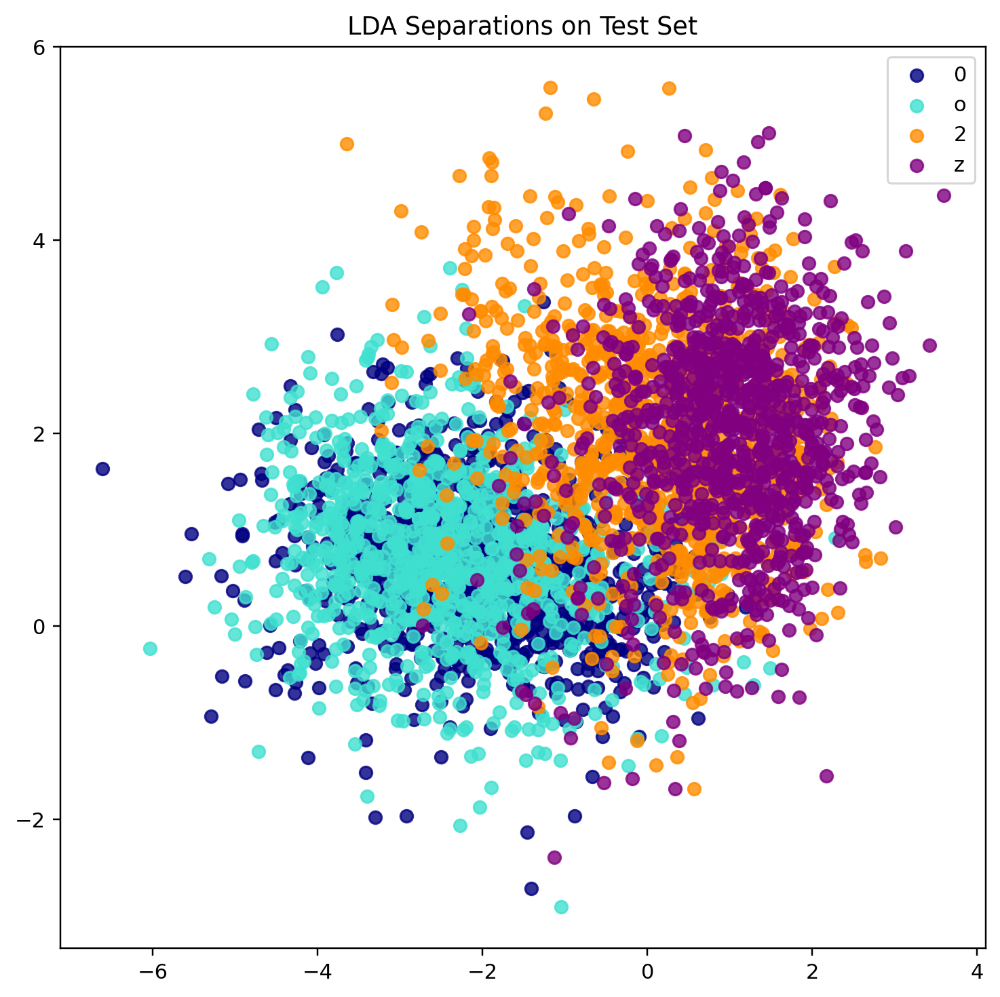

Demonstration ended. 


In [2]:
matplotlib.rcParams['figure.figsize'] = (8, 8)
Symbols = "0o2z"
classes = [SymbolsToLabels(Sym) for Sym in Symbols]
LdaInstance = LDADimReduce()
Data, Labels = SplitbyClasses(classSize=1000, classes=classes)
# new data that never seemed before.
Embeddings = LdaInstance.getEmbeddings(Data);
colors = ['navy', 'turquoise', 'darkorange', "purple"]
SeparatingModes = [0, 5]
for color, II in zip(colors, classes):
    scatter(
        Embeddings[Labels == II, SeparatingModes[0]],
        Embeddings[Labels == II, SeparatingModes[1]],
        alpha=.8,
        color=color
    )
legend(list(Symbols))
title("LDA Separations on Test Set")
show()
print("Demonstration ended. ")

#### Pure PCA Separation


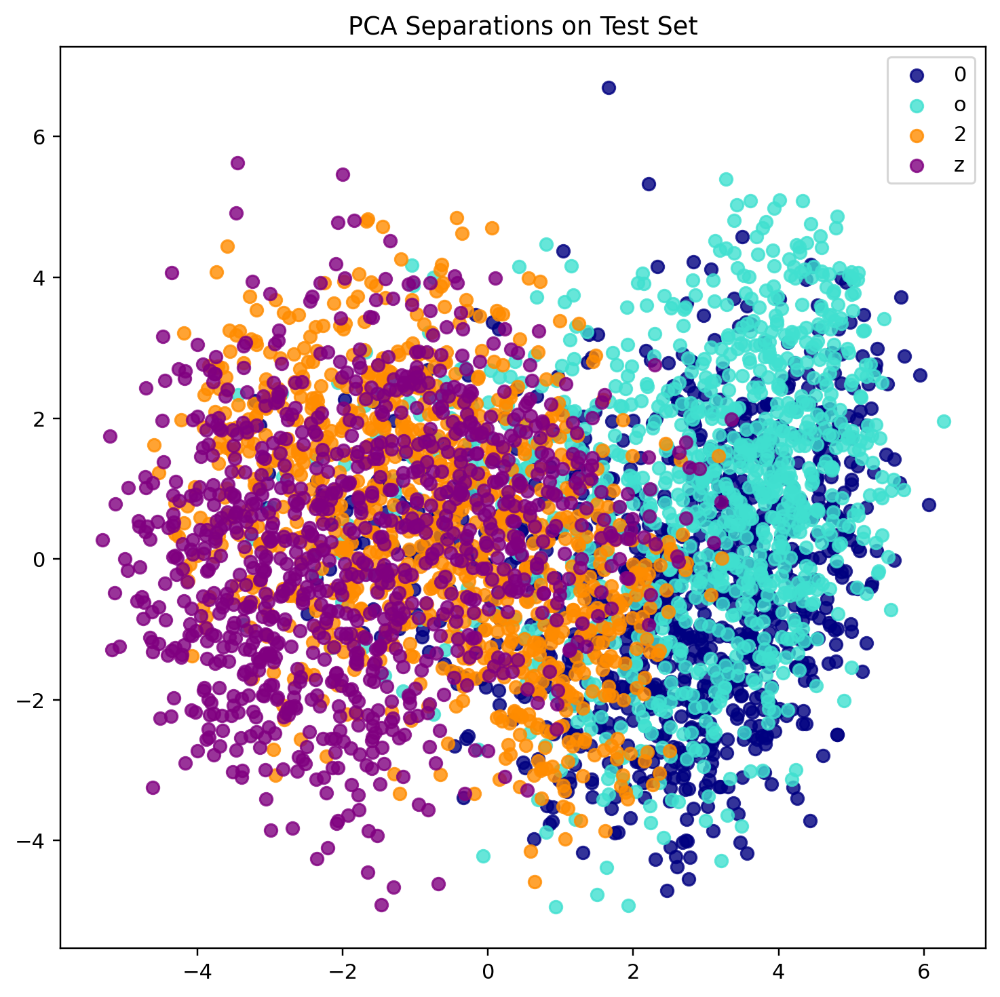

Demonstration ended. 


In [3]:
Symbols = "0o2z"
classes = [SymbolsToLabels(Sym) for Sym in Symbols]
LdaInstance = PCADimReduce()
Data, Labels = SplitbyClasses(classSize=1000, classes=classes)
# new data that never seemed before.
Embeddings = LdaInstance.getEmbeddings(Data);
colors = ['navy', 'turquoise', 'darkorange', "purple"]
SeparatingModes = [0, 5]
for color, II in zip(colors, classes):
    scatter(
        Embeddings[Labels == II, SeparatingModes[0]],
        Embeddings[Labels == II, SeparatingModes[1]],
        alpha=.8,
        color=color
    )
legend(list(Symbols))
title("PCA Separations on Test Set")
show()
print("Demonstration ended. ")

#### PCA + LDA Separations

Getting PCA Model...
Getting PCA Embeddings...
Train LDA on PCA Embeddings... 
Represent using PCA modes and then on LDA basis... 


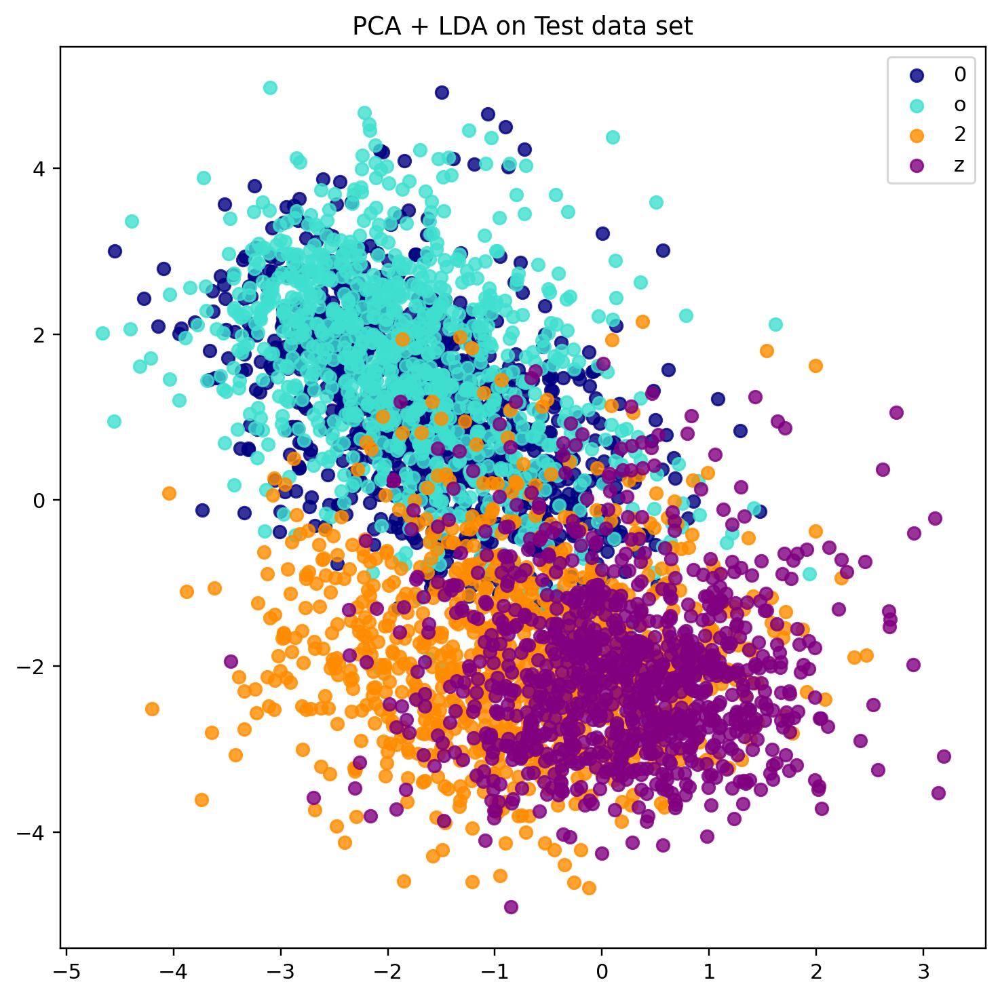

In [4]:
PCAInstance = PCADimReduce(n_components=0.8); print("Getting PCA Model...")
PCAEmbeddings = PCAInstance.getEmbeddings(); print("Getting PCA Embeddings...")

TrainLabels = PCAInstance.Labels
print("Train LDA on PCA Embeddings... ")
LDAMaxComponents = min(61, PCAInstance.PcaModel.n_components_ - 1)
LDAInstance = LDADimReduce(n_components=LDAMaxComponents,  # Just to be sure.
                           X=PCAEmbeddings,
                           y=TrainLabels)  # Use the PCA embeddings to train LDA

classes = [SymbolsToLabels(Char) for Char in "0o2z"]
TestData, TestLabels = SplitbyClasses(classSize=1000, classes=classes)
# Ge the LDA embeddings of the PCA embeddings.
print("Represent using PCA modes and then on LDA basis... ")
Embeddings = LDAInstance.getEmbeddings(PCAInstance.getEmbeddings(TestData))
colors = ['navy', 'turquoise', 'darkorange', "purple"]

## Plotting the Results
SeparatingModes = [0, 1]
for color, II in zip(colors, classes):
    scatter(
        Embeddings[TestLabels == II, SeparatingModes[0]],
        Embeddings[TestLabels == II, SeparatingModes[1]],
        alpha=.8,
        color=color
    )
legend(list("0o2z"))
title("PCA + LDA on Test data set")
show()

#### PCA + LDA Embeddings Version 2


### SVM
* SVM trained on big subsets. 
    * LDA Embeddings for 26 lower cased letters 
    * LDA Embeddings for 26 lower cased letters and digits
    * PCA + LDA Embeddings for 26 lower cased letters and digits
* SVM trained on all equally sampled 62 symbols
    * With LDA embeddings
* SVM trained on the hardest to 4 symbols

#### SVM on 26 lower cased Letters, with LDA Embeddings

Setup the SVM, plitting the training set and the test sets and get their LDA embeddings.

In [2]:
DisplayLabels = "abcdefghijklmnopqrstuvwxyz"
classes = [SymbolsToLabels(II) for II in DisplayLabels]
Model = make_pipeline(StandardScaler(), SVC(gamma="auto"))  # Making the SVC Model.

TrainX, TrainY = SplitbyClasses(classes=classes, classSize=1000)
TestX, TestY = SplitbyClasses(classes=classes, classSize=500, shuffle_data=True, test_set=True)

DimRe = LDADimReduce(X=TrainX, y=TrainY)  # Use Train set to create LDA embeddings.
TrainEmbeddings = DimRe.getEmbeddings()  # Get Embeddings from the set trained LDA
TestEmbeddings = DimRe.getEmbeddings(TestX) # Get the embeddings from the test set.

Model.fit(TrainEmbeddings, TrainY); print(f"Modeling Has been fitted: ")
print(Model)

Modeling Has been fitted: 
Pipeline(steps=[('standardscaler', StandardScaler()),
                ('svc', SVC(gamma='auto'))])


Over all accuracy is: 0.805351783927976


(<Figure size 4400x4400 with 2 Axes>,
 (<AxesSubplot:title={'center':'False Positive'}>,
  <AxesSubplot:title={'center':'False Negative'}>))

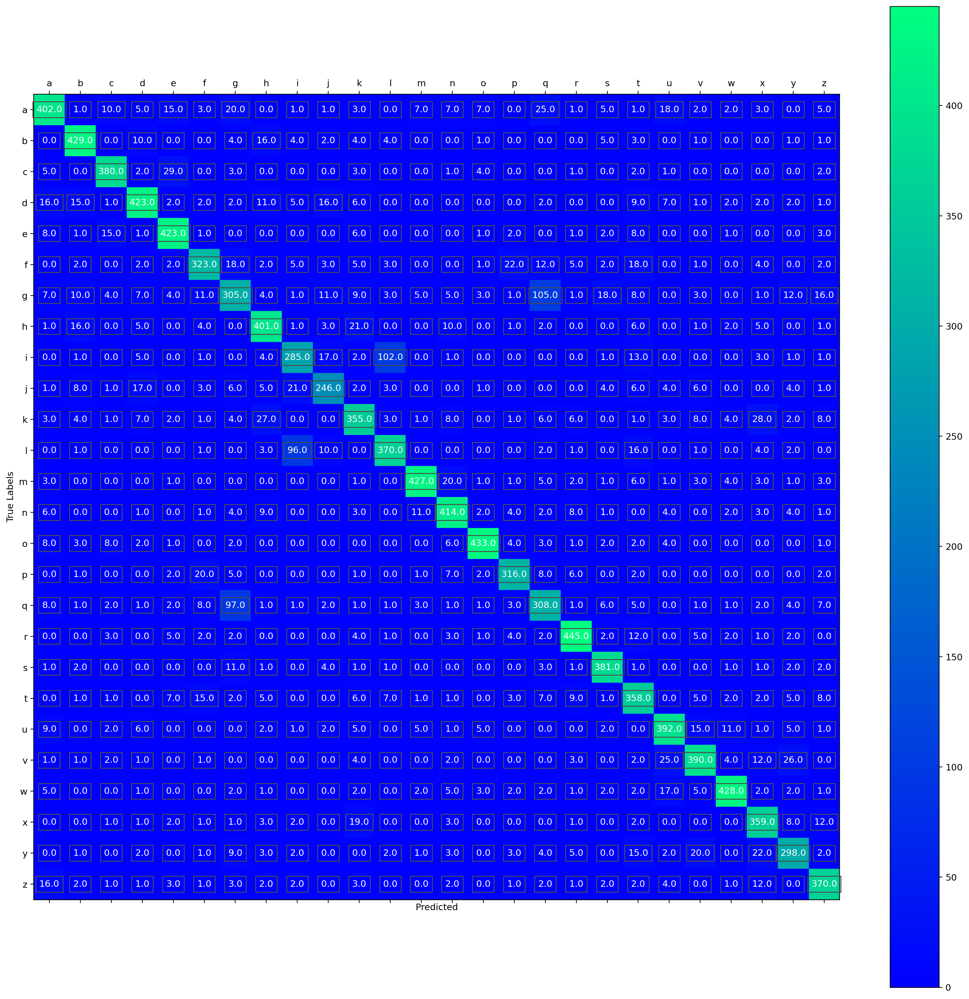

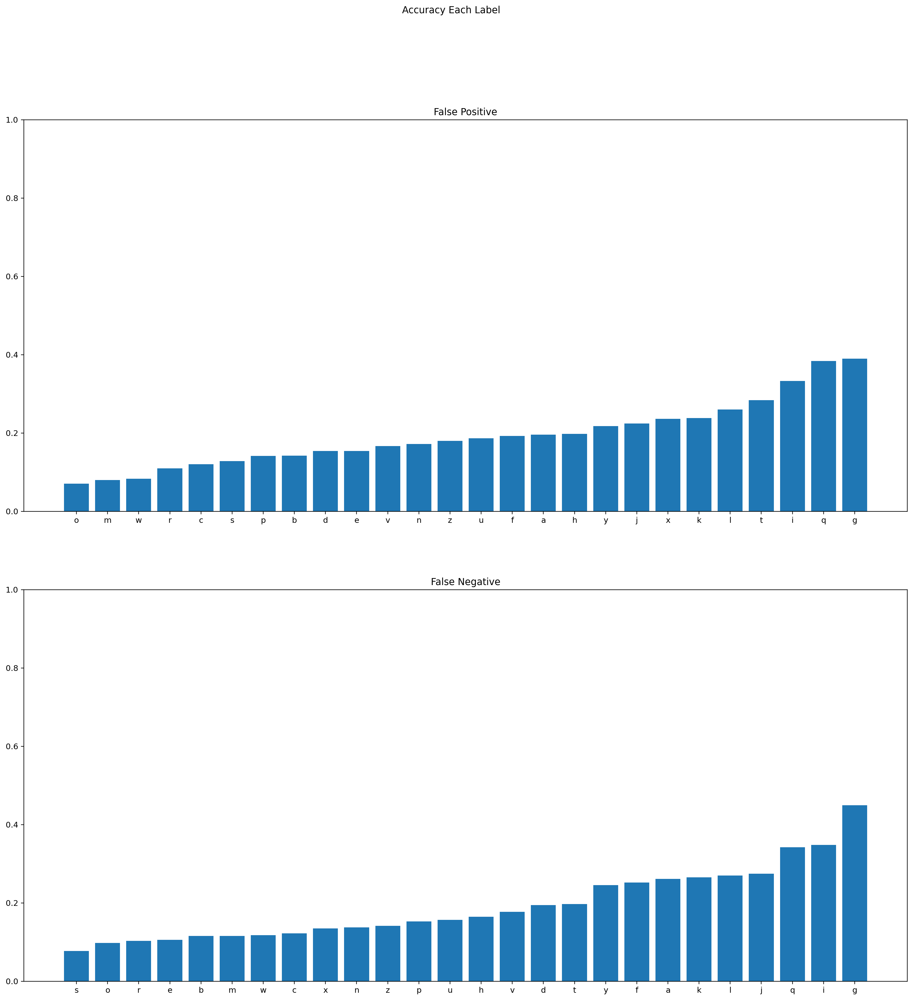

In [3]:
matplotlib.rcParams['figure.figsize'] = (20, 20)
PredictedLabels = Model.predict(TestEmbeddings)
Conmat = ConfusionMatrix(PredictedLabels, TestY)
Conmat.visualize()
Conmat.report()

Over all accuracy is: 0.9434615384615385


(<Figure size 4400x4400 with 2 Axes>,
 (<AxesSubplot:title={'center':'False Positive'}>,
  <AxesSubplot:title={'center':'False Negative'}>))

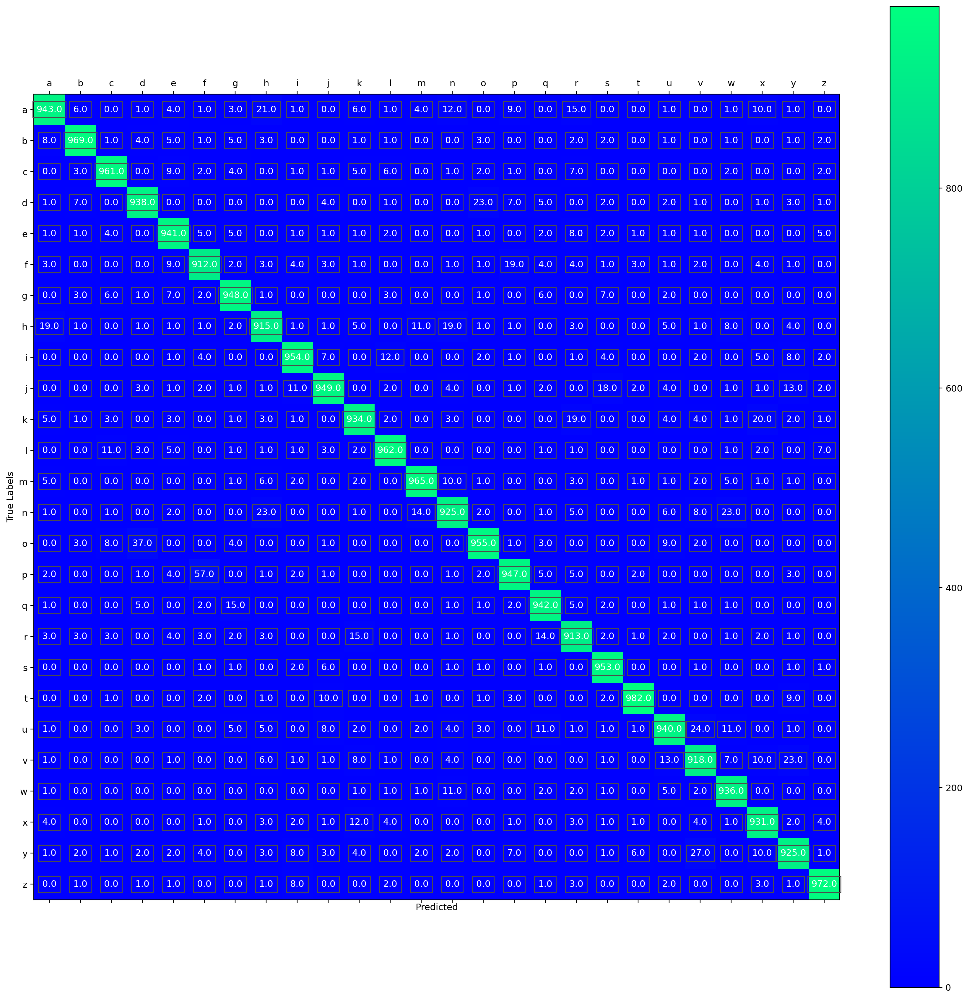

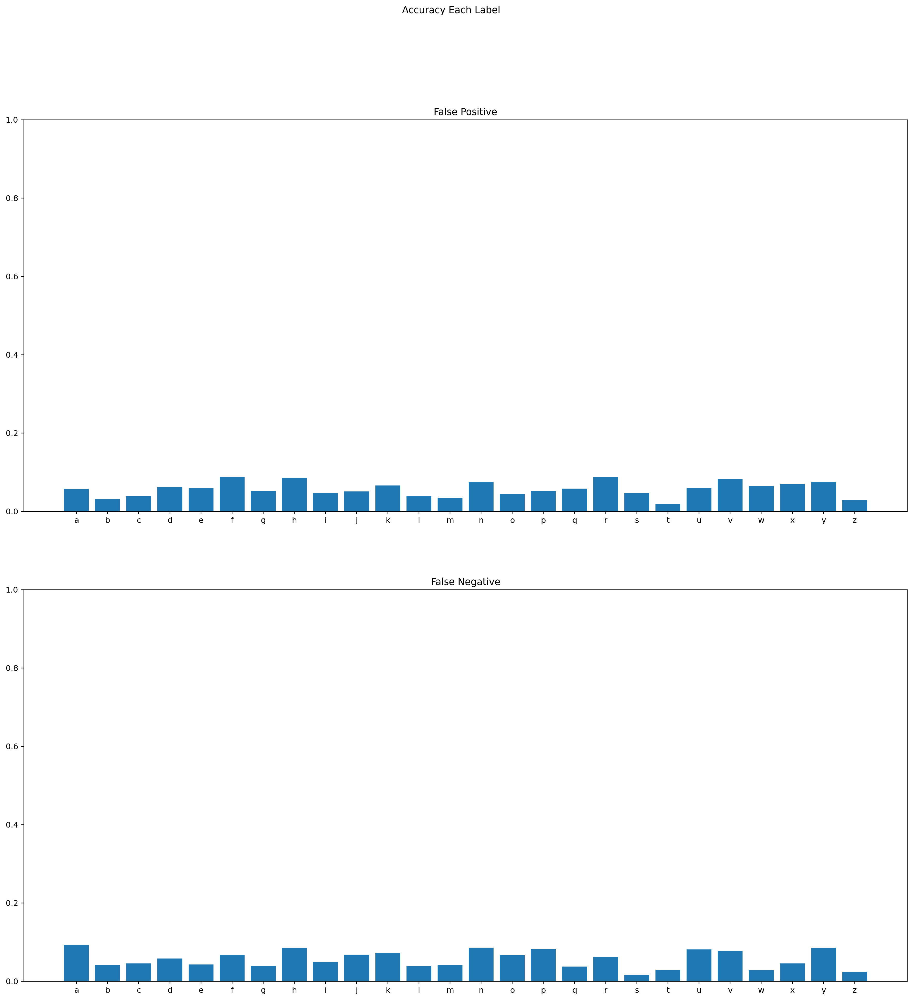

In [7]:
PredictedLabels = Model.predict(TrainEmbeddings)
Conmat = ConfusionMatrix(PredictedLabels, TrainY)
Conmat.visualize()
Conmat.report()

#### SVM with LDA on [a-z] + [0, 9]

In [8]:
DisplayLabels = "".join(map(str, range(10))) + "abcdefghijklmnopqrstuvwxyz"
classes = [SymbolsToLabels(II) for II in DisplayLabels]
Model = make_pipeline(StandardScaler(), SVC(gamma="auto"))  # Making the SVC Model.

TrainX, TrainY = SplitbyClasses(classes=classes, classSize=1000)
TestX, TestY = SplitbyClasses(classes=classes, classSize=3000, shuffle_data=True, test_set=True)

DimRe = LDADimReduce(X=TrainX, y=TrainY)  # Use Train set to create LDA embeddings.
TrainEmbeddings = DimRe.getEmbeddings()  # Get Embeddings from the set trained LDA
TestEmbeddings = DimRe.getEmbeddings(TestX) # Get the embeddings from the test set.

Model.fit(TrainEmbeddings, TrainY); print(f"Modeling Has been fitted: ")
print(Model)

Modeling Has been fitted: 
Pipeline(steps=[('standardscaler', StandardScaler()),
                ('svc', SVC(gamma='auto'))])


Over all accuracy is: 0.8057538286250461


(<Figure size 6600x6600 with 2 Axes>,
 (<AxesSubplot:title={'center':'False Positive'}>,
  <AxesSubplot:title={'center':'False Negative'}>))

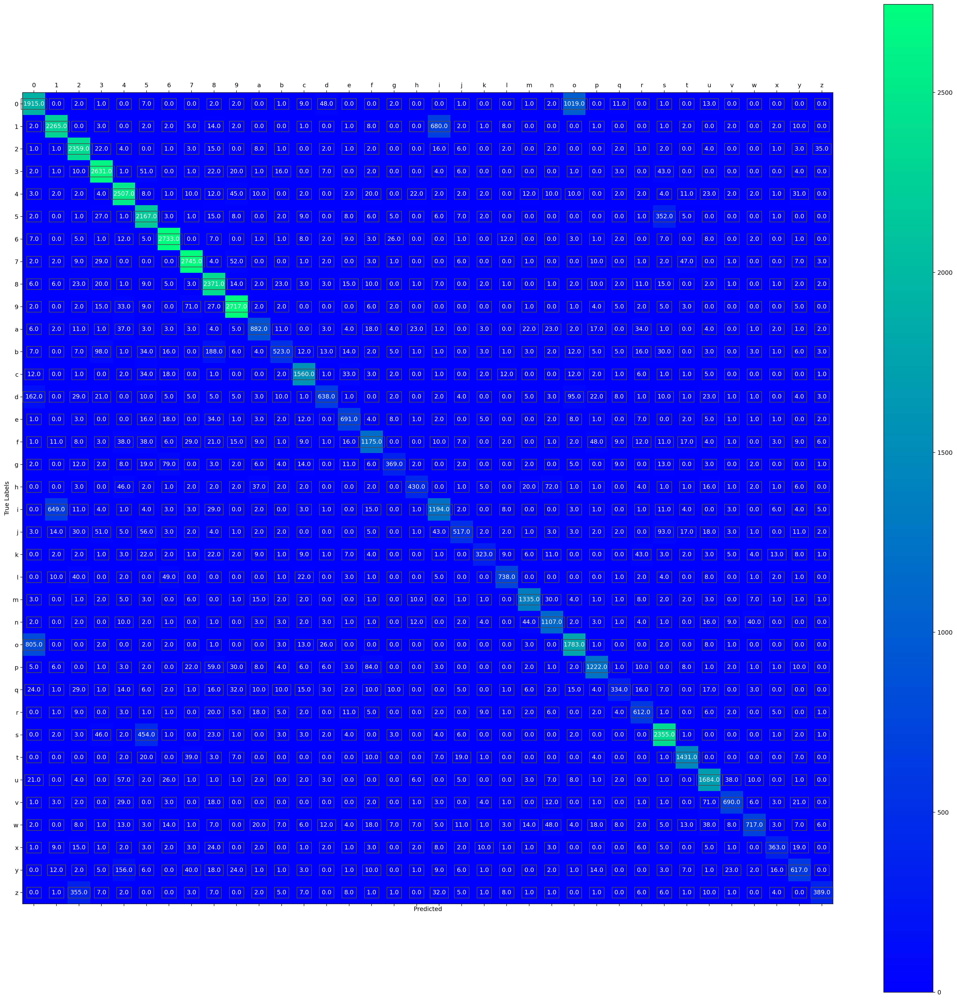

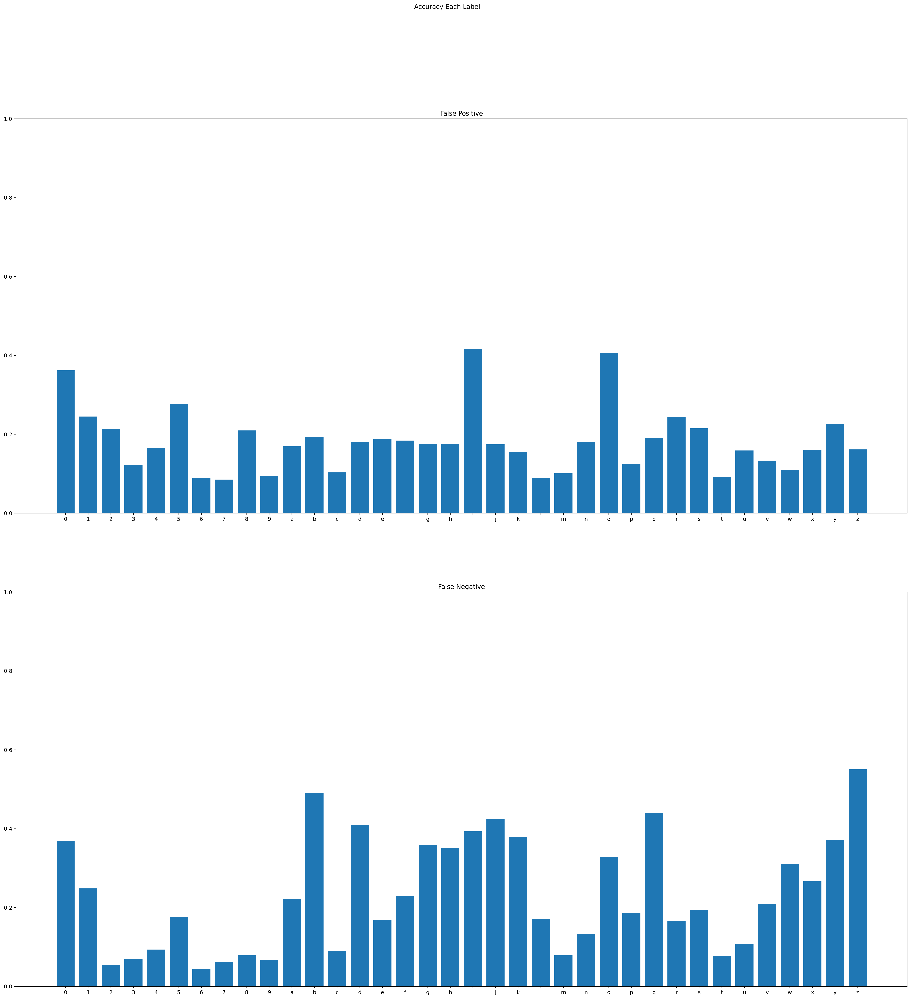

In [9]:
matplotlib.rcParams['figure.figsize'] = (30, 30)
PredictedLabels = Model.predict(TestEmbeddings)
Conmat = ConfusionMatrix(PredictedLabels, TestY)
Conmat.visualize()
Conmat.report()

Over all accuracy is: 0.9196388888888889


(<Figure size 6600x6600 with 2 Axes>,
 (<AxesSubplot:title={'center':'False Positive'}>,
  <AxesSubplot:title={'center':'False Negative'}>))

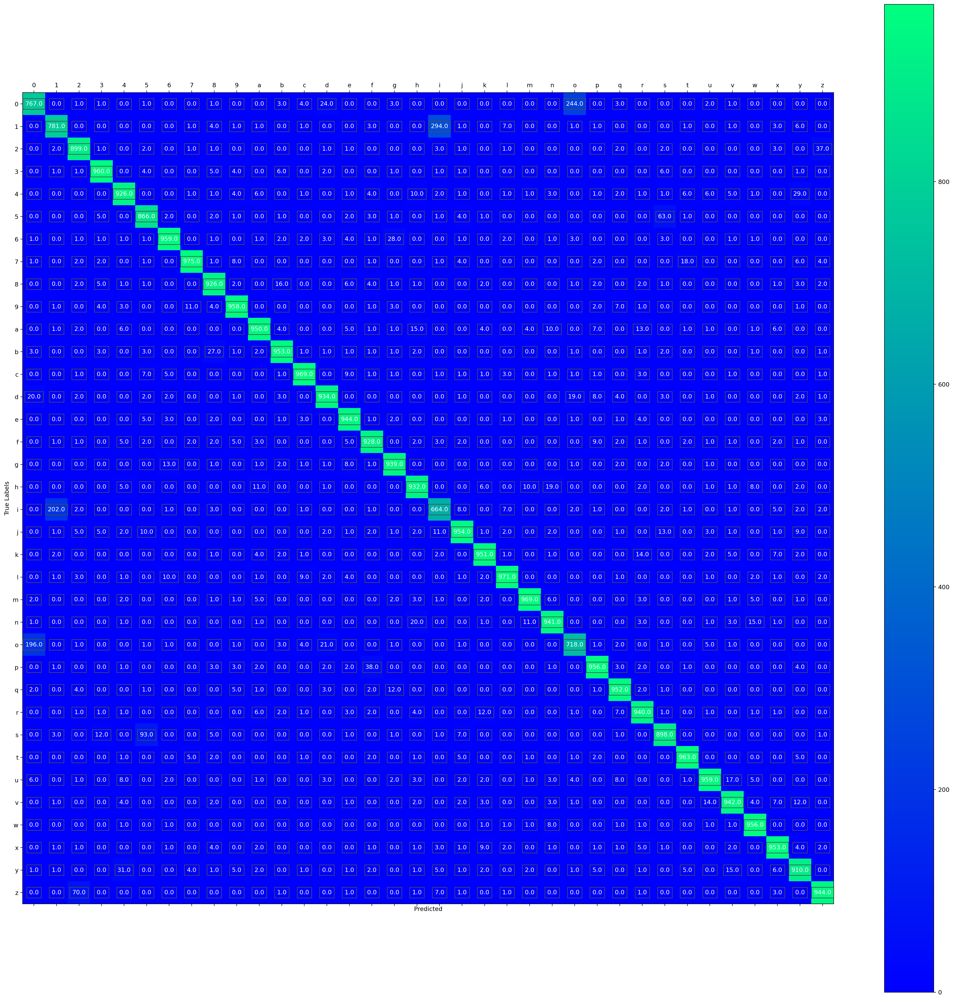

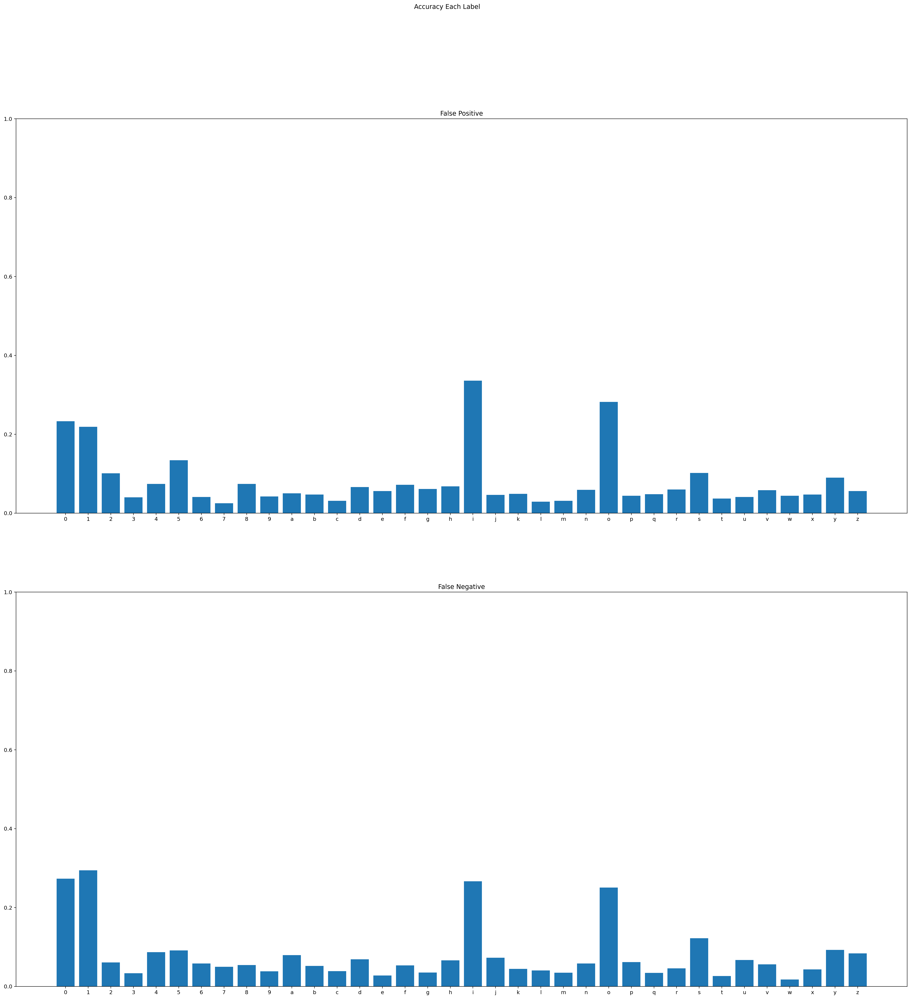

In [10]:
matplotlib.rcParams['figure.figsize'] = (30, 30)
PredictedLabels = Model.predict(TrainEmbeddings)
Conmat = ConfusionMatrix(PredictedLabels, TrainY)
Conmat.visualize()
Conmat.report()

### SVM with PCA + LDA Embeddings on [a-z] + [0, 9]

In [11]:
DisplayLabels = "".join(map(str, range(10))) + "abcdefghijklmnopqrstuvwxyz"
classes = [SymbolsToLabels(II) for II in DisplayLabels]
Model = make_pipeline(StandardScaler(), SVC(gamma="auto"))  # Making the SVC Model.

TrainX, TrainY = SplitbyClasses(classes=classes, classSize=1000)
TestX, TestY = SplitbyClasses(classes=classes, classSize=1000, shuffle_data=True, test_set=True)

DimRe = DimReduceHybrid(X=TrainX, y=TrainY)  # Use Train set to create LDA embeddings.
TrainEmbeddings = DimRe.getEmbeddings()  # Get Embeddings from the set trained LDA
TestEmbeddings = DimRe.getEmbeddings(TestX) # Get the embeddings from the test set.

Model.fit(TrainEmbeddings, TrainY); print(f"Modeling Has been fitted: ")
print(Model)

Modeling Has been fitted: 
Pipeline(steps=[('standardscaler', StandardScaler()),
                ('svc', SVC(gamma='auto'))])


Over all accuracy is: 0.8653129291740239


(<Figure size 6600x6600 with 2 Axes>,
 (<AxesSubplot:title={'center':'False Positive'}>,
  <AxesSubplot:title={'center':'False Negative'}>))

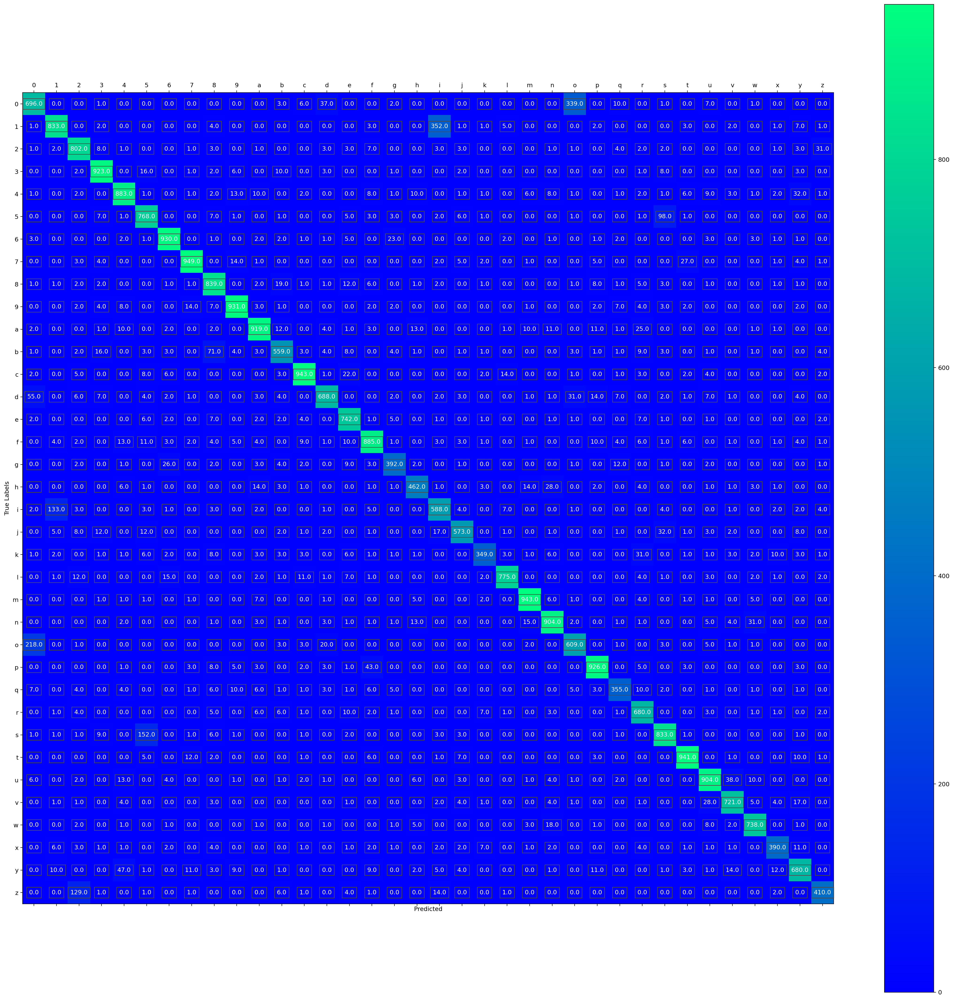

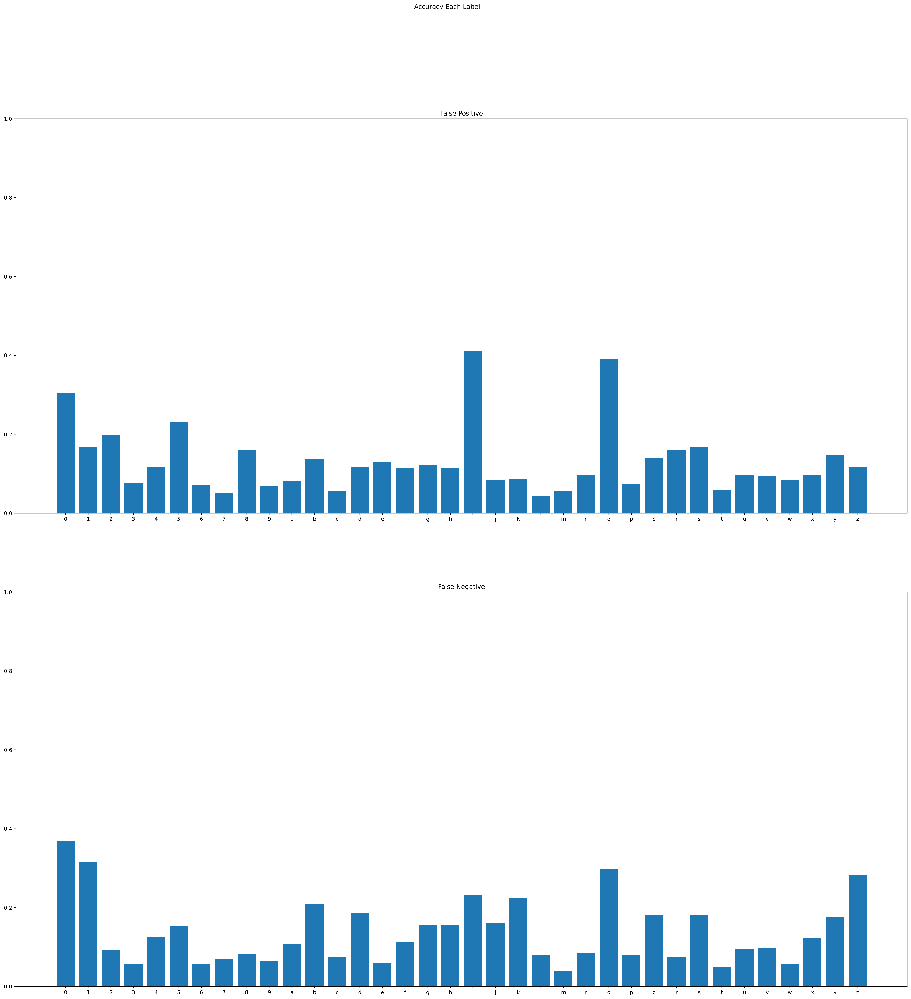

In [12]:
matplotlib.rcParams['figure.figsize'] = (30, 30)
PredictedLabels = Model.predict(TestEmbeddings)
Conmat = ConfusionMatrix(PredictedLabels, TestY)
Conmat.visualize()
Conmat.report()

Over all accuracy is: 0.9259444444444445


(<Figure size 6600x6600 with 2 Axes>,
 (<AxesSubplot:title={'center':'False Positive'}>,
  <AxesSubplot:title={'center':'False Negative'}>))

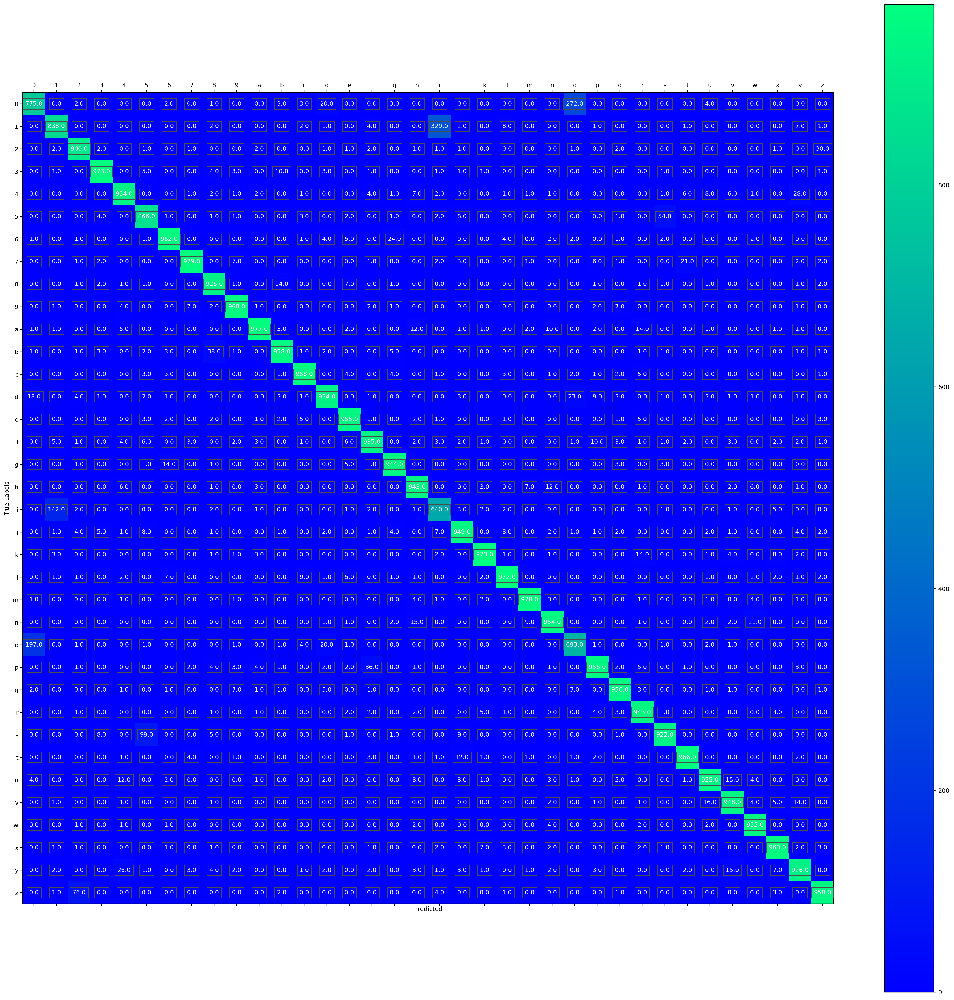

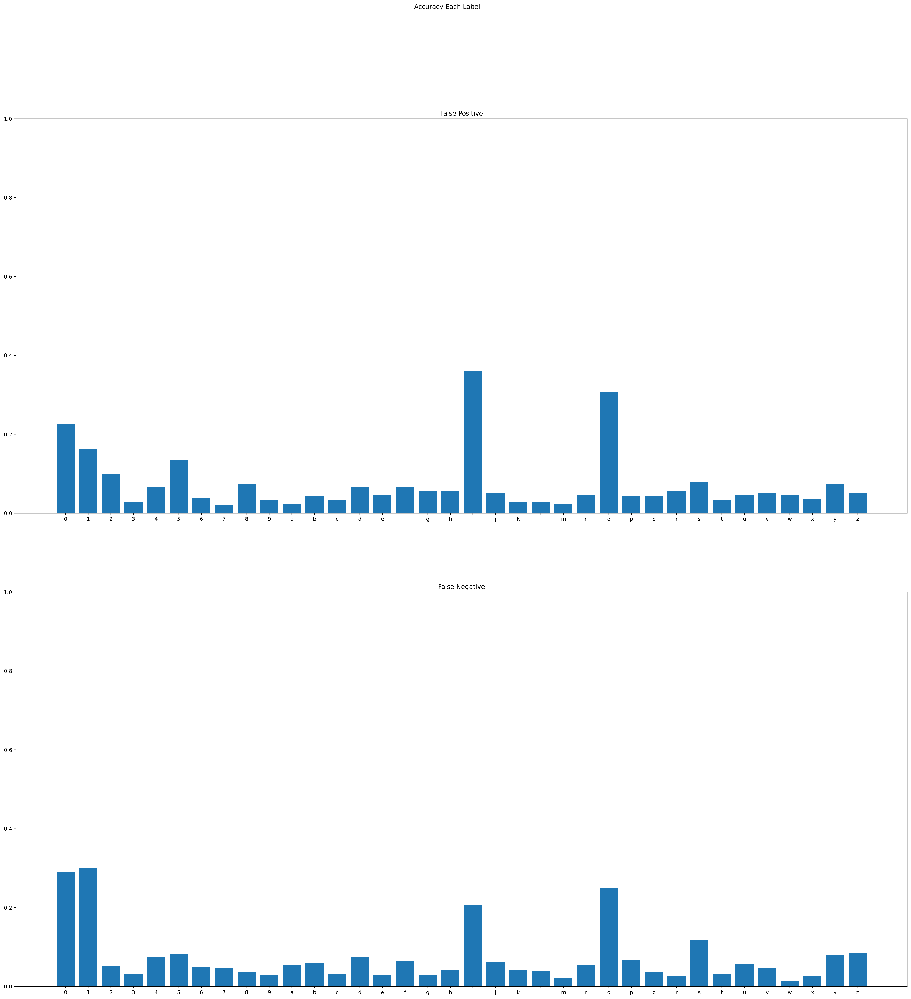

In [13]:
matplotlib.rcParams['figure.figsize'] = (30, 30)
PredictedLabels = Model.predict(TrainEmbeddings)
Conmat = ConfusionMatrix(PredictedLabels, TrainY)
Conmat.visualize()
Conmat.report()

#### Linear SVM with LDA for [0-9] + [a-z] + [A-Z]

Training the Model 

In [12]:
DisplayLabels = DisplayLabels =\
    "".join(map(str, range(10))) + "abcdefghijklmnopqrstuvwxyz" + "abcdefghijklmnopqrstuvwxyz".upper()
classes = [SymbolsToLabels(II) for II in DisplayLabels]
Model = make_pipeline(StandardScaler(), LinearSVC())  # Making the SVC Model.

TrainX, TrainY = SplitbyClasses(classes=classes, classSize=2000)
TestX, TestY = SplitbyClasses(classes=classes, classSize=1000, shuffle_data=True,  test_set=True)

DimRe = LDADimReduce(X=TrainX, y=TrainY)  # Use Train set to create LDA embeddings.
TrainEmbeddings = DimRe.getEmbeddings()  # Get Embeddings from the set trained LDA
TestEmbeddings = DimRe.getEmbeddings(TestX) # Get the embeddings from the test set.

Model.fit(TrainEmbeddings, TrainY); print(f"Modeling Has been fitted: ")
print(Model)

Modeling Has been fitted: 
Pipeline(steps=[('standardscaler', StandardScaler()),
                ('linearsvc', LinearSVC())])


C:\Users\victo\anaconda3\envs\ml_optimization\lib\site-packages\sklearn\svm\_base.py:977: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)


#### Confusion Matrix on the Test set

Over all accuracy is: 0.5058160552897395


(<Figure size 8800x8800 with 2 Axes>,
 (<AxesSubplot:title={'center':'False Positive'}>,
  <AxesSubplot:title={'center':'False Negative'}>))

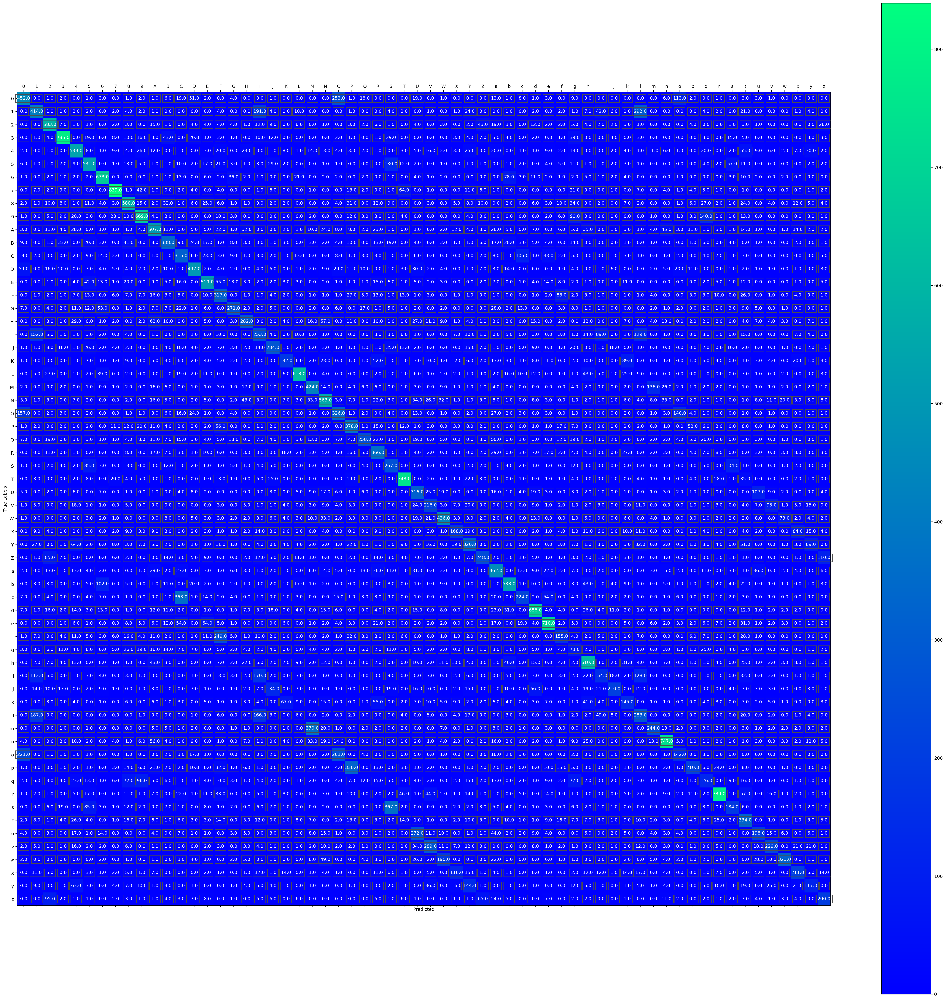

In [5]:
# Graphics settings! 
matplotlib.rcParams['figure.figsize'] = (40, 40)
PredictedLabels = Model.predict(TestEmbeddings)
Conmat = ConfusionMatrix(PredictedLabels, TestY)
Conmat.visualize()
Conmat.report()

Over all accuracy is: 0.6204838709677419


(<Figure size 8800x8800 with 2 Axes>,
 (<AxesSubplot:title={'center':'False Positive'}>,
  <AxesSubplot:title={'center':'False Negative'}>))

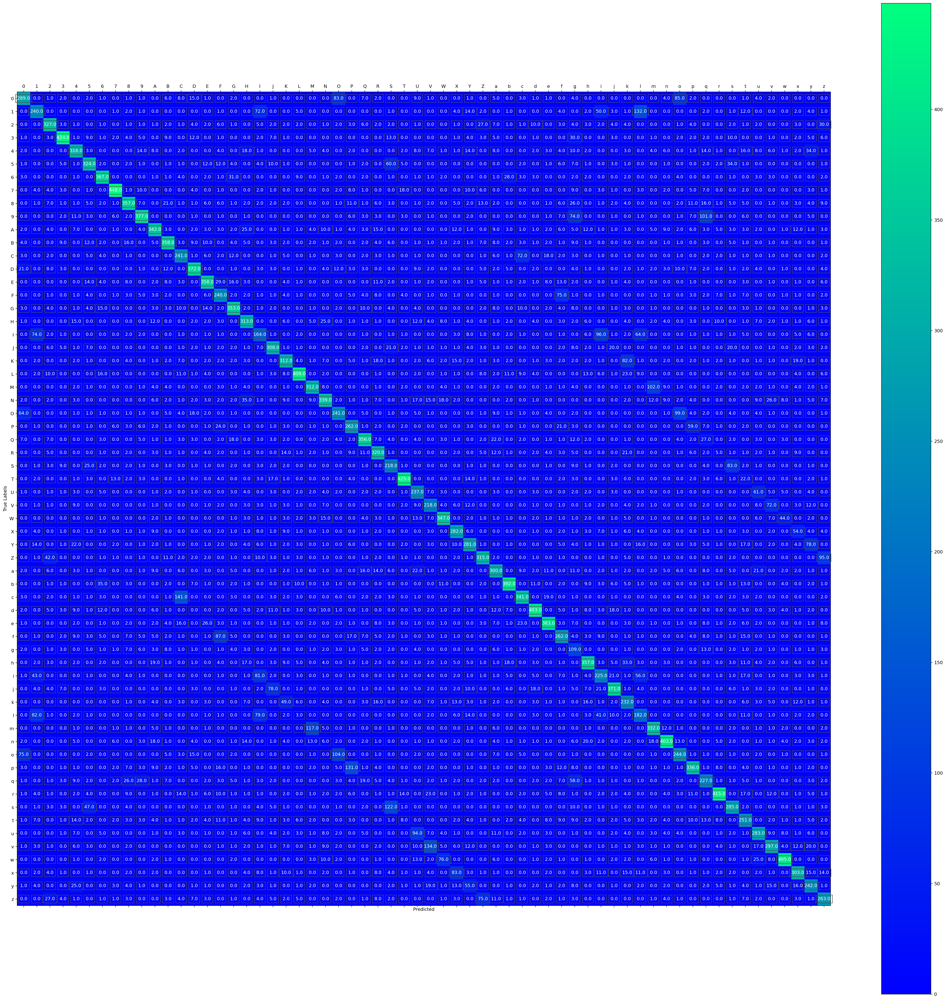

In [6]:
PredictedLabels = Model.predict(TrainEmbeddings)
Conmat = ConfusionMatrix(PredictedLabels, TrainY)
Conmat.visualize()
Conmat.report()

#### SVM on Hardest Symbols to Separate

In [7]:
DisplayLabels = DisplayLabels = "0oOz25sS"
classes = [SymbolsToLabels(II) for II in DisplayLabels]
Model = make_pipeline(StandardScaler(), SVC(gamma="auto"))  # Making the SVC Model.

TrainX, TrainY = SplitbyClasses(classes=classes, classSize=1000)
TestX, TestY = SplitbyClasses(classes=classes, classSize=3000, shuffle_data=True, test_set=True)

DimRe = LDADimReduce(X=TrainX, y=TrainY)  # Use Train set to create LDA embeddings.
TrainEmbeddings = DimRe.getEmbeddings()  # Get Embeddings from the set trained LDA
TestEmbeddings = DimRe.getEmbeddings(TestX) # Get the embeddings from the test set.

Model.fit(TrainEmbeddings, TrainY); print(f"Modeling Has been fitted: ")
print(Model)

Modeling Has been fitted: 
Pipeline(steps=[('standardscaler', StandardScaler()),
                ('svc', SVC(gamma='auto'))])


Over all accuracy is: 0.5508132566956097


0.5508132566956097

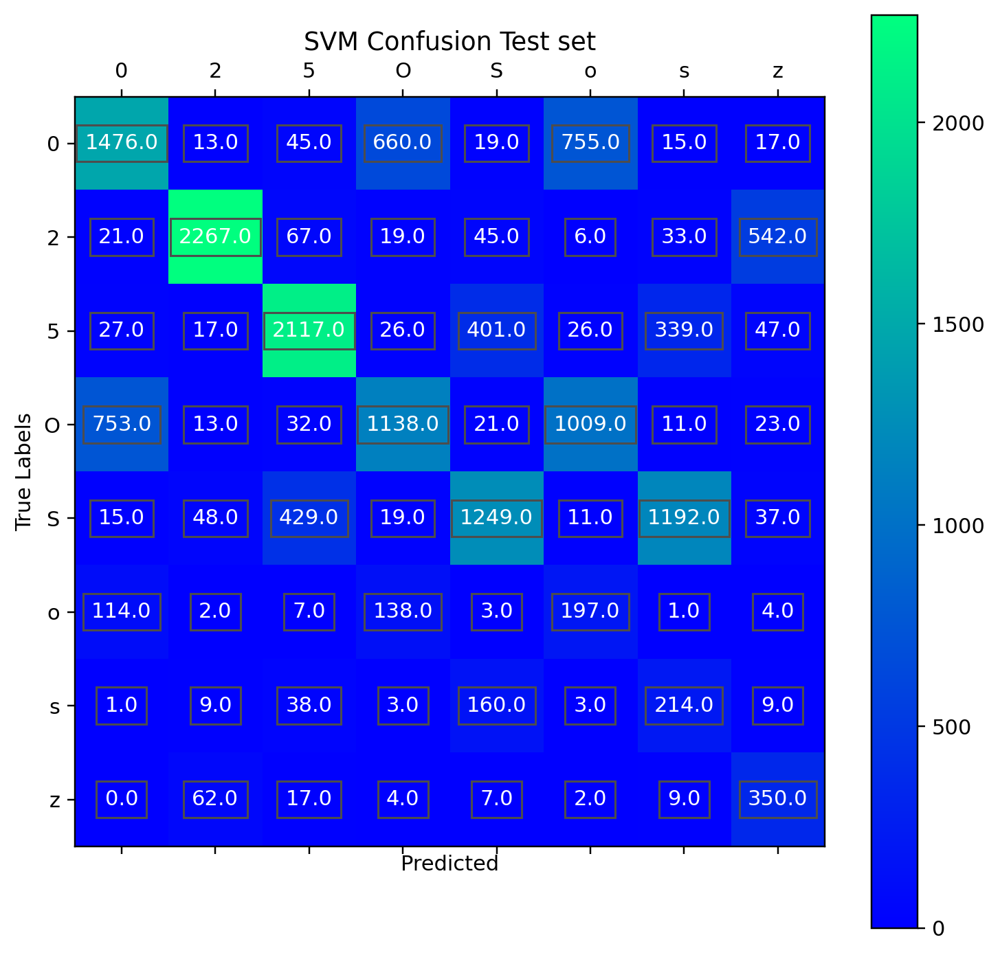

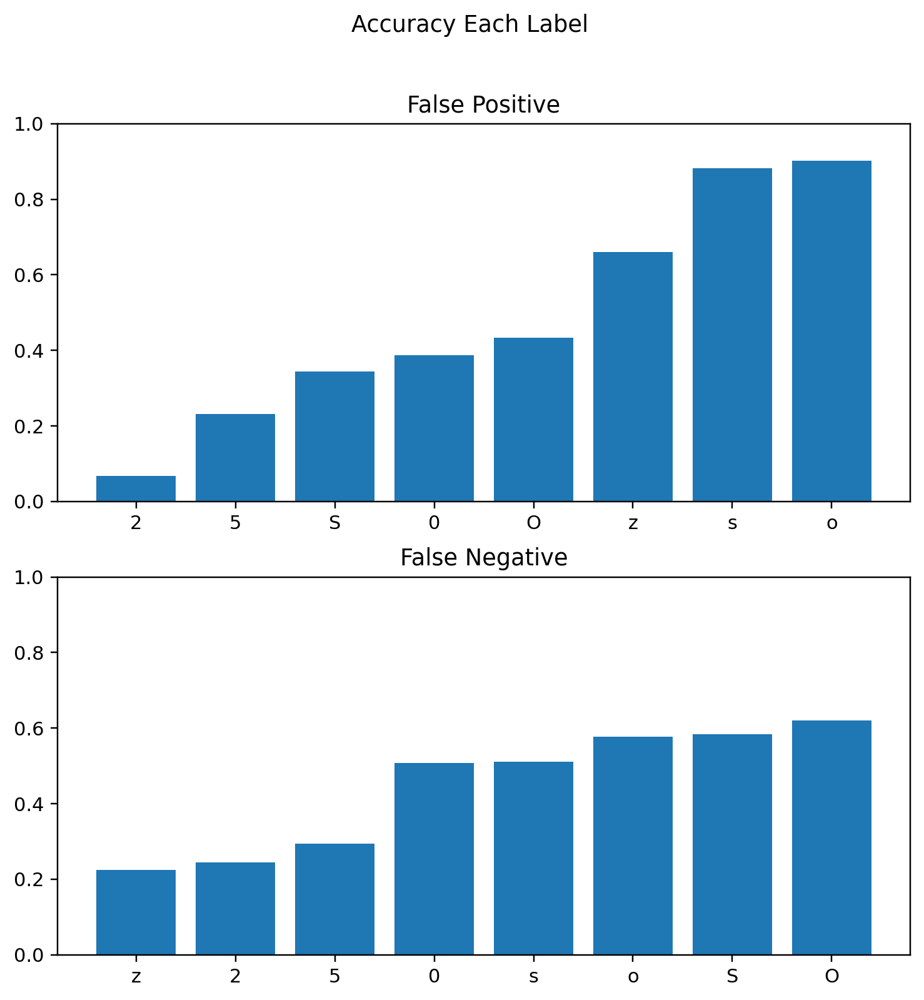

In [10]:
matplotlib.rcParams['figure.figsize'] = (8, 8)
PredictedLabels = Model.predict(TestEmbeddings)
Conmat = ConfusionMatrix(TestY, PredictedLabels)
_, ax = Conmat.visualize()
ax.set_title("SVM Confusion Test set")
_, ax = Conmat.report()
Model.score(TestEmbeddings, TestY)

Over all accuracy is: 0.6895


(<Figure size 1760x1760 with 2 Axes>,
 (<AxesSubplot:title={'center':'False Positive'}>,
  <AxesSubplot:title={'center':'False Negative'}>))

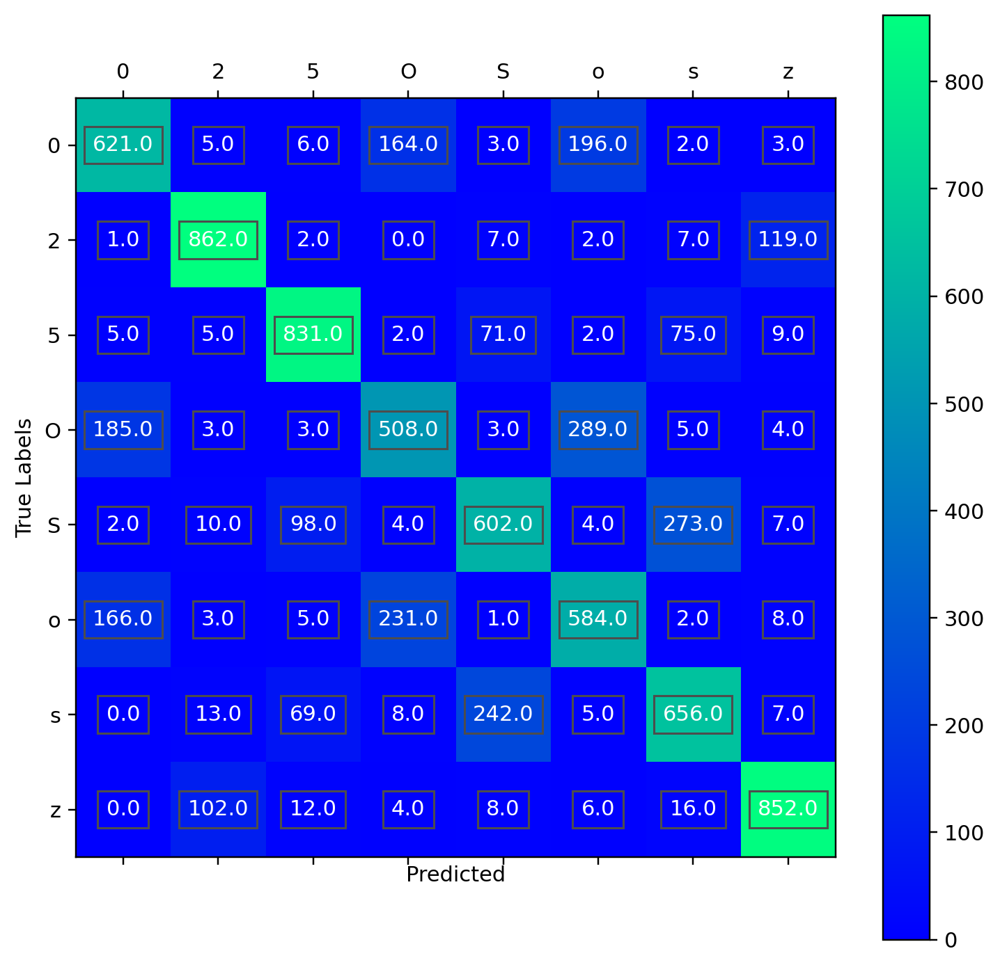

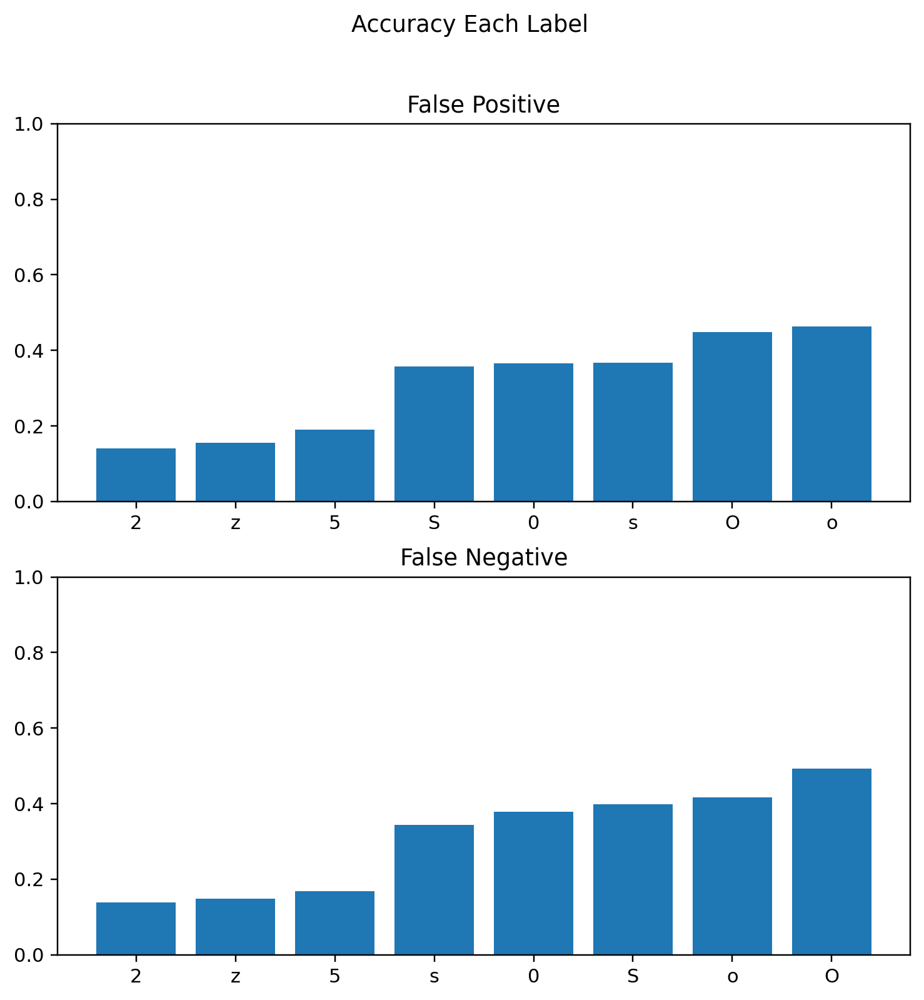

In [11]:
matplotlib.rcParams['figure.figsize'] = (8, 8)
PredictedLabels = Model.predict(TrainEmbeddings)
Conmat = ConfusionMatrix(TrainY, PredictedLabels)
Conmat.visualize()
Conmat.report()

### SVM Only on Digits with PCA + LDA 

In [10]:
DisplayLabels = "0123456789"
classes = [SymbolsToLabels(II) for II in DisplayLabels]
Model = make_pipeline(StandardScaler(), SVC(gamma="auto", kernel='poly', degree=3))  # Making the SVC Model.

TrainX, TrainY = SplitbyClasses(classes=classes, classSize=10000)
TestX, TestY = SplitbyClasses(classes=classes, classSize=1000, shuffle_data=True, test_set=True)

DimRe = DimReduceHybrid(X=TrainX, y=TrainY, pca_components=0.7)  # Use Train set to create LDA embeddings.
TrainEmbeddings = DimRe.getEmbeddings()  # Get Embeddings from the set trained LDA
TestEmbeddings = DimRe.getEmbeddings(TestX) # Get the embeddings from the test set.

Model.fit(TrainEmbeddings, TrainY); print(f"Modeling Has been fitted: ")
print(Model)

Modeling Has been fitted: 
Pipeline(steps=[('standardscaler', StandardScaler()),
                ('svc', SVC(gamma='auto', kernel='poly'))])


Over all accuracy is: 0.9317


(<Figure size 1760x1760 with 2 Axes>,
 (<AxesSubplot:title={'center':'False Positive'}>,
  <AxesSubplot:title={'center':'False Negative'}>))

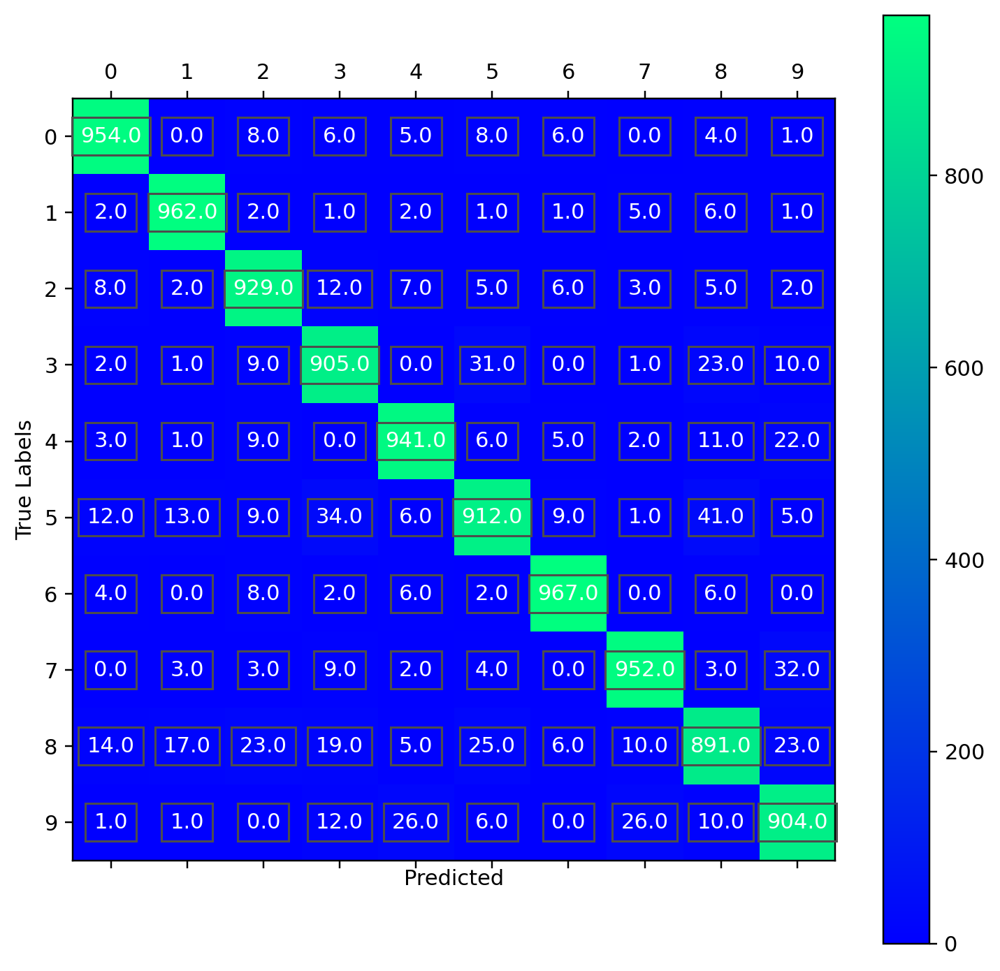

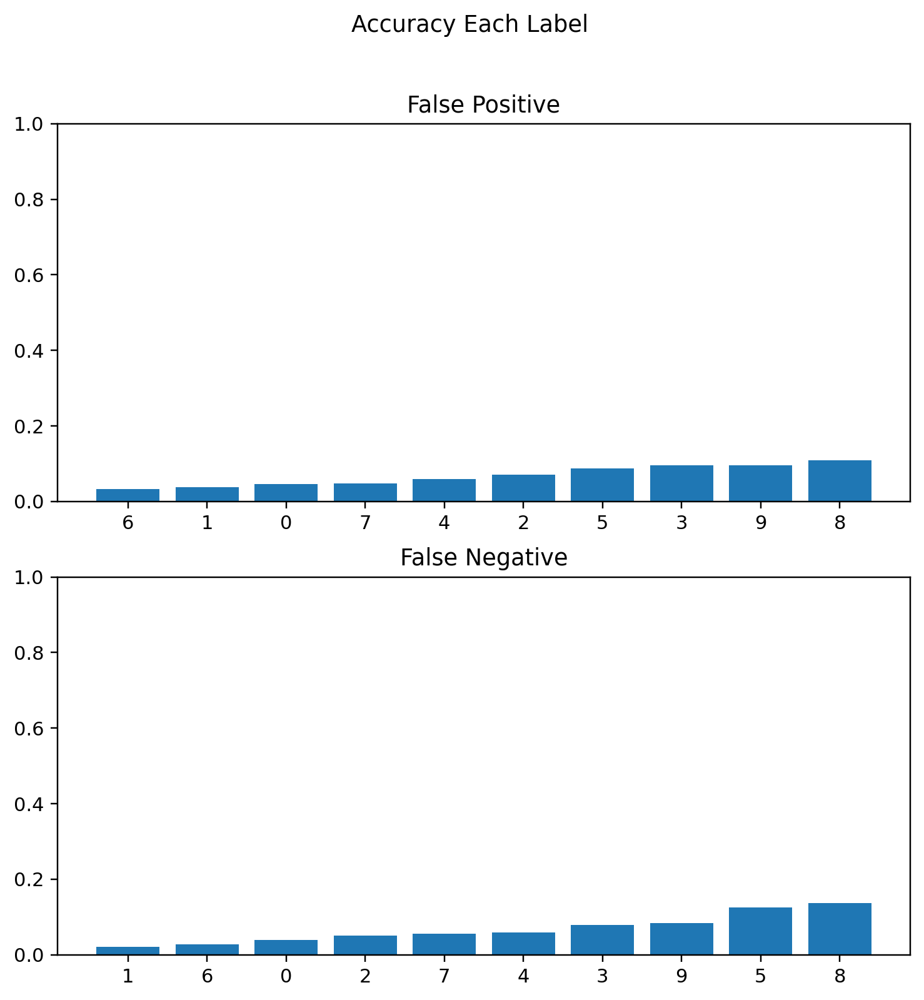

In [7]:
# Graphics settings! 
matplotlib.rcParams['figure.figsize'] = (8, 8)
PredictedLabels = Model.predict(TestEmbeddings)
Conmat = ConfusionMatrix(PredictedLabels, TestY)
Conmat.visualize()
Conmat.report()

Over all accuracy is: 0.93368


(<Figure size 1760x1760 with 2 Axes>,
 (<AxesSubplot:title={'center':'False Positive'}>,
  <AxesSubplot:title={'center':'False Negative'}>))

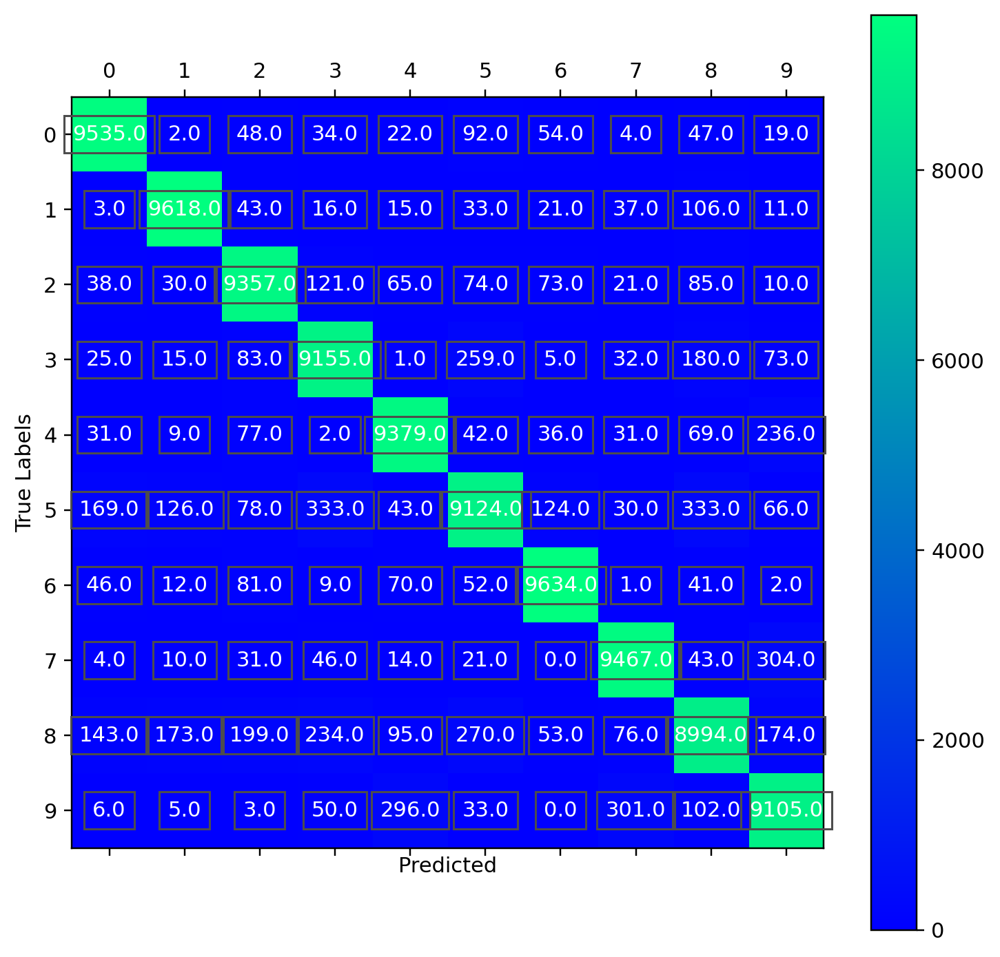

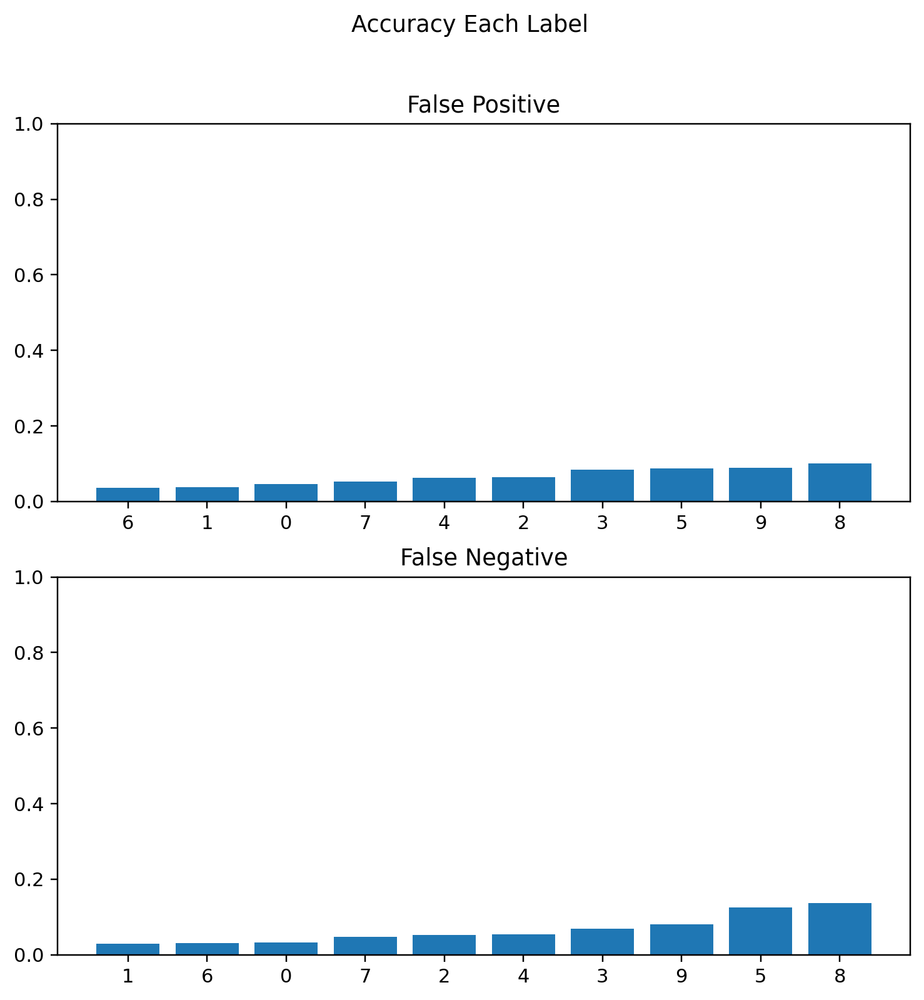

In [8]:
matplotlib.rcParams['figure.figsize'] = (8, 8)
PredictedLabels = Model.predict(TrainEmbeddings)
Conmat = ConfusionMatrix(PredictedLabels, TrainY)
Conmat.visualize()
Conmat.report()

### Decision Tree

Due to some of the inhrant draw backs of a single decision tree, here we will explore the performance of Ensemble Tree under a optimal dimeision for embeddings. 

#### Hardest Separations on Random Forest: 
With PCA + LDA Dimensoinality Reduction. 

In [3]:
Symbols = "0o2zZO"
classes = [SymbolsToLabels(II) for II in Symbols]
TrainX, TrainY = SplitbyClasses(classes=classes, classSize=2000)
TestX, TestY = SplitbyClasses(classes=classes, classSize=1000, shuffle_data=True, test_set=True)

DimRe = DimReduceHybrid(X=TrainX, y=TrainY, pca_components=0.9)  # Use Train set to create LDA embeddings.
TrainEmbeddings = DimRe.getEmbeddings()  # Get Embeddings from the set trained LDA
TestEmbeddings = DimRe.getEmbeddings(TestX)  # Get the embeddings from the test set.
Model = RandomForestClassifier(n_estimators=200, n_jobs=-1,  min_samples_leaf=10)
Model.fit(TrainEmbeddings, TrainY)


RandomForestClassifier(min_samples_leaf=10, n_estimators=200, n_jobs=-1)

Over all accuracy is: 0.5745263638438712


(<Figure size 2200x2200 with 2 Axes>,
 (<AxesSubplot:title={'center':'False Positive'}>,
  <AxesSubplot:title={'center':'False Negative'}>))

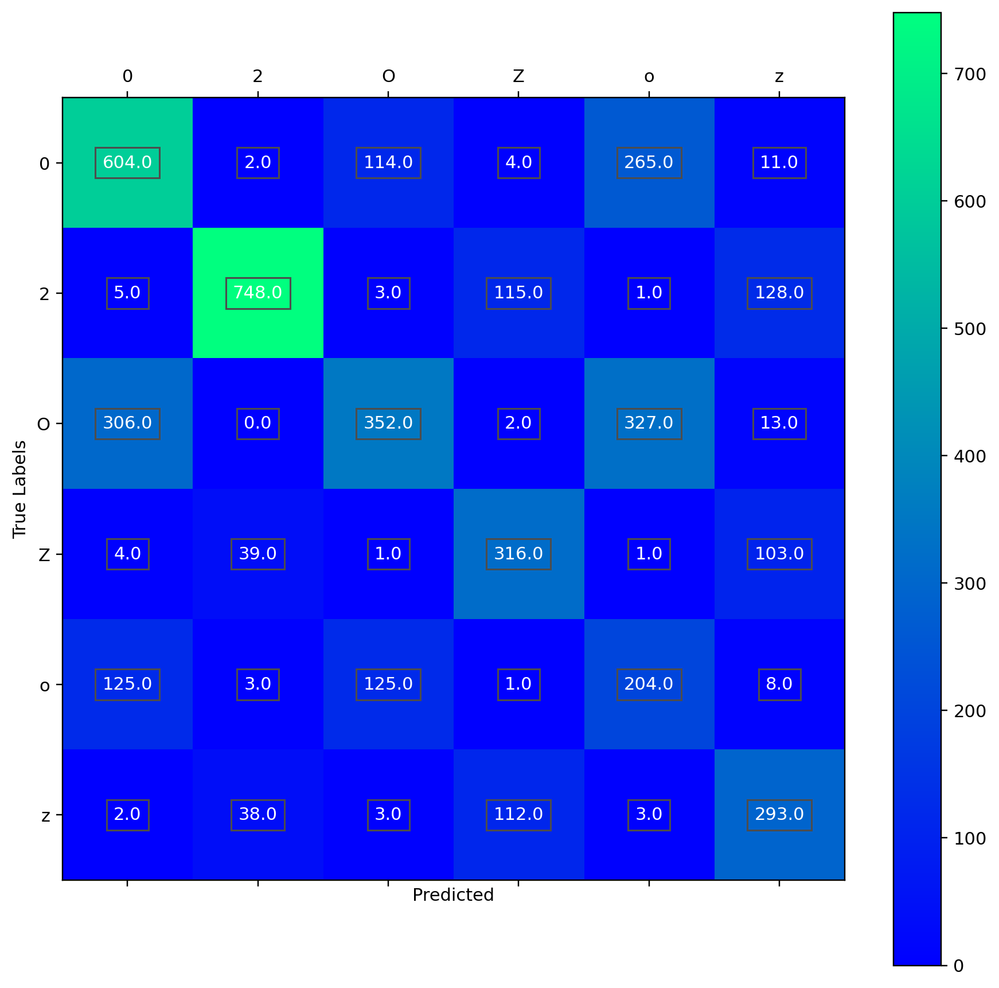

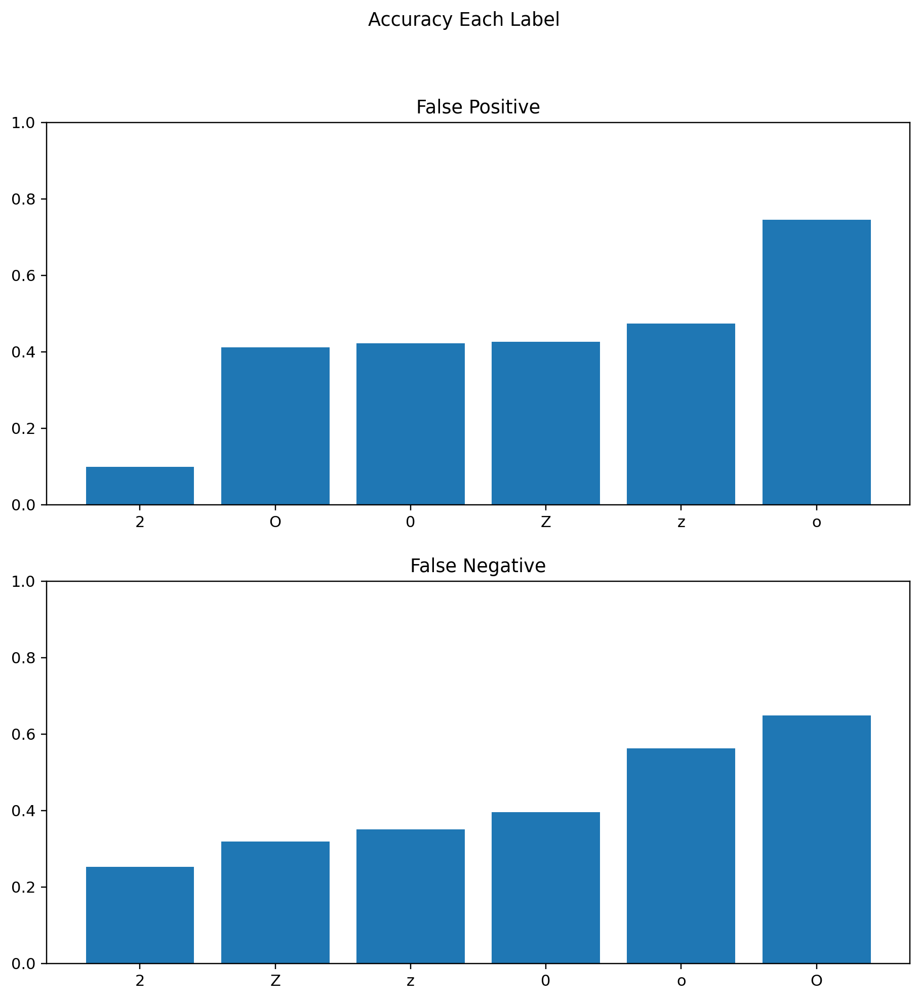

In [4]:
PredictedTestLabels = Model.predict(TestEmbeddings)
Conmat = ConfusionMatrix(TestY, PredictedTestLabels)
Conmat.visualize()
Conmat.report()

Over all accuracy is: 0.7385833333333334


(<Figure size 2200x2200 with 2 Axes>,
 (<AxesSubplot:title={'center':'False Positive'}>,
  <AxesSubplot:title={'center':'False Negative'}>))

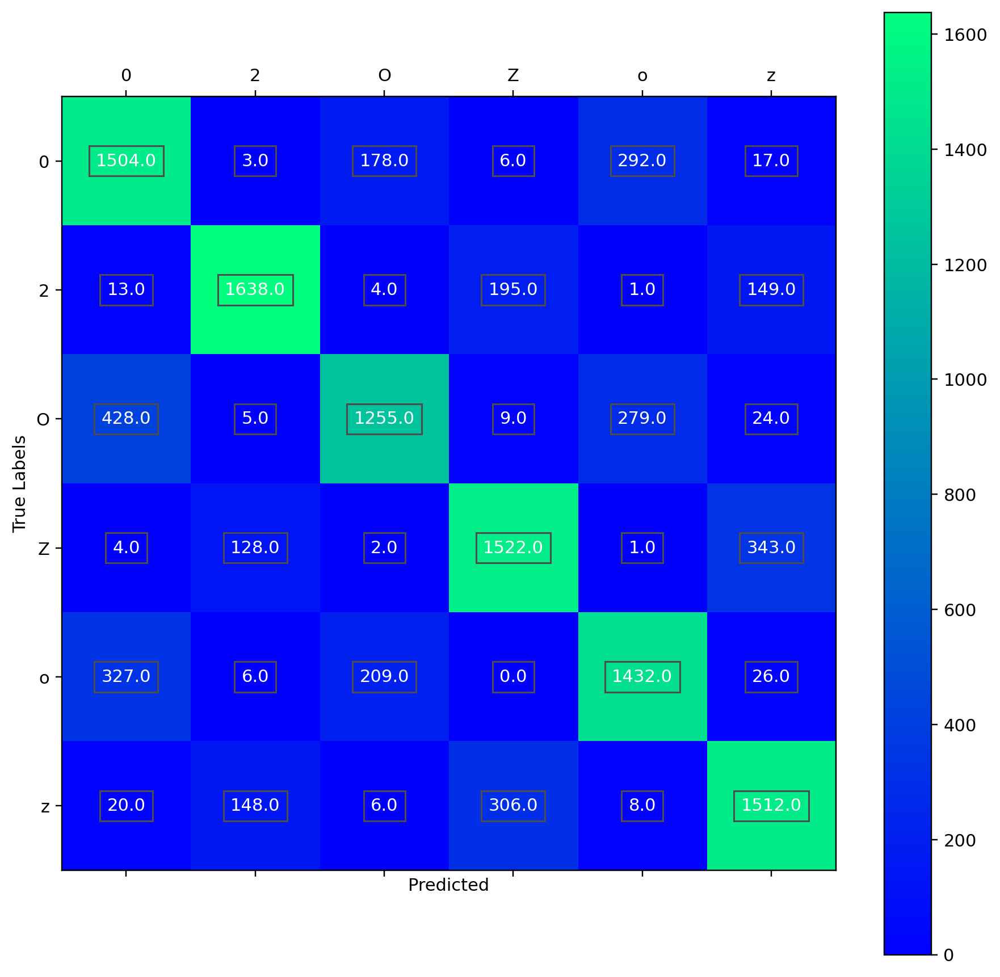

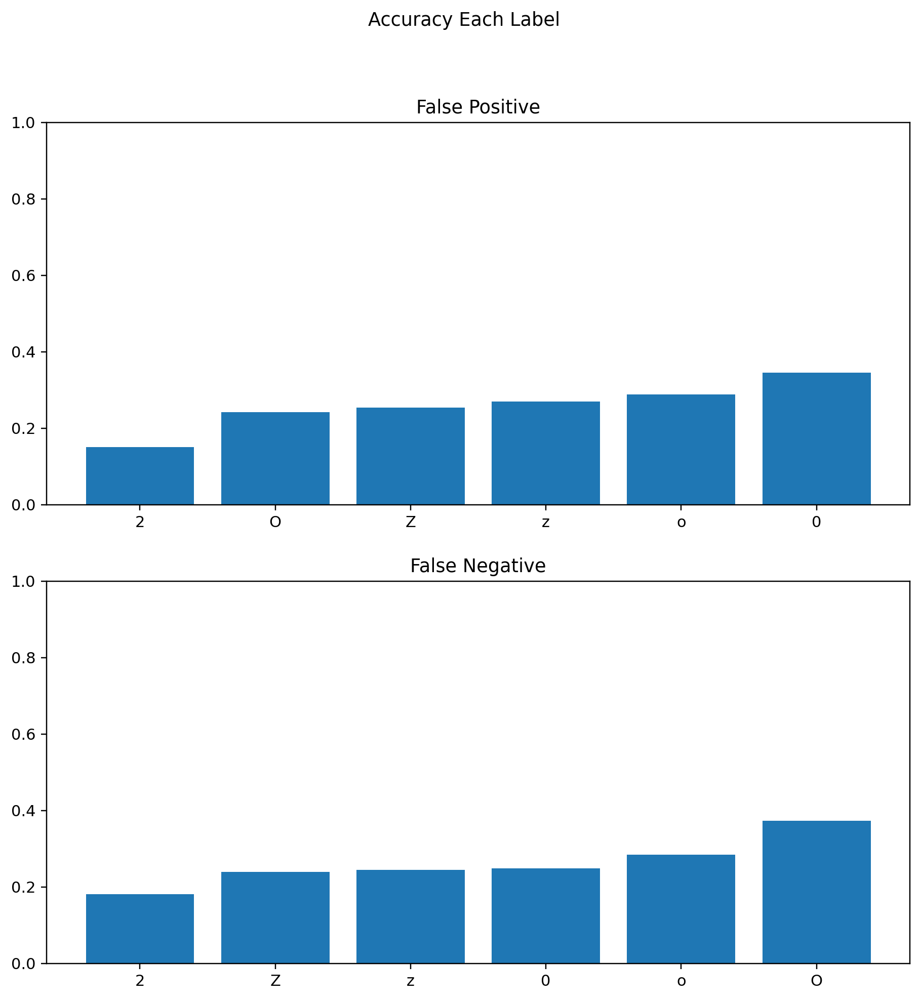

In [5]:
PredictedTestLabels = Model.predict(TrainEmbeddings)
Conmat = ConfusionMatrix(TrainY, PredictedTestLabels)
Conmat.visualize()
Conmat.report()

#### Random Forest Separating all labels with PCA + LDA 
* This is hard. 

In [3]:
Symbols = \
    "".join(map(str, range(10))) + "abcdefghijklmnopqrstuvwxyz" + "abcdefghijklmnopqrstuvwxyz".upper()
classes = [SymbolsToLabels(II) for II in Symbols]
TrainX, TrainY = SplitbyClasses(classes=classes, classSize=2000)
TestX, TestY = SplitbyClasses(classes=classes, classSize=1000, shuffle_data=True, test_set=True)

DimRe = DimReduceHybrid(X=TrainX, y=TrainY, pca_components=0.9)  # Use Train set to create LDA embeddings.
TrainEmbeddings = DimRe.getEmbeddings()  # Get Embeddings from the set trained LDA
TestEmbeddings = DimRe.getEmbeddings(TestX)  # Get the embeddings from the test set.
Model = RandomForestClassifier(n_estimators=200, n_jobs=-1, min_samples_leaf=1/(1000*62))
Model.fit(TrainEmbeddings, TrainY)


RandomForestClassifier(min_samples_leaf=1.6129032258064517e-05,
                       n_estimators=200, n_jobs=-1)

Over all accuracy is: 0.6717703349282297


(<Figure size 6600x6600 with 2 Axes>,
 (<AxesSubplot:title={'center':'False Positive'}>,
  <AxesSubplot:title={'center':'False Negative'}>))

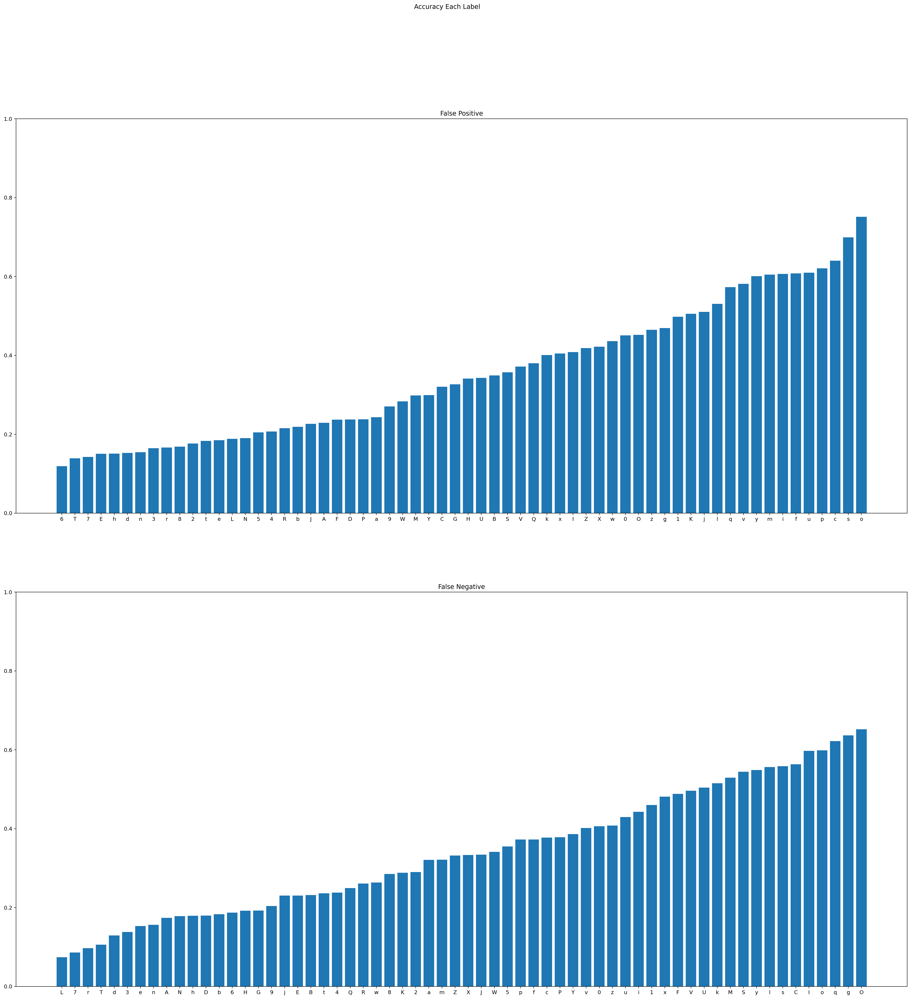

In [4]:
matplotlib.rcParams['figure.figsize'] = (60, 60)
PredictedTestLabels = Model.predict(TestEmbeddings)
Conmat = ConfusionMatrix(TestY, PredictedTestLabels)
Conmat.visualize()
matplotlib.rcParams['figure.figsize'] = (30, 30)
Conmat.report()

In [5]:
matplotlib.rcParams['figure.figsize'] = (60, 60)
PredictedTestLabels = Model.predict(TrainEmbeddings)
Conmat = ConfusionMatrix(TrainY, PredictedTestLabels)
Conmat.visualize()
Conmat.report()

Over all accuracy is: 0.9991202298702138


(<Figure size 13200x13200 with 2 Axes>,
 (<AxesSubplot:title={'center':'False Positive'}>,
  <AxesSubplot:title={'center':'False Negative'}>))

### Random Forest Separating Digits and Lower Cased Letters


In [14]:
Symbols = \
    "".join(map(str, range(10))) + "abcdefghijklmnopqrstuvwxyz"
classes = [SymbolsToLabels(II) for II in Symbols]
TrainX, TrainY = SplitbyClasses(classes=classes, classSize=2000)
TestX, TestY = SplitbyClasses(classes=classes, classSize=1000, shuffle_data=True, test_set=True)

DimRe = DimReduceHybrid(X=TrainX, y=TrainY, pca_components=0.9)  # Use Train set to create LDA embeddings.
TrainEmbeddings = DimRe.getEmbeddings()  # Get Embeddings from the set trained LDA
TestEmbeddings = DimRe.getEmbeddings(TestX)  # Get the embeddings from the test set.

Model = RandomForestClassifier(n_estimators=200, n_jobs=-1)
Model.fit(TrainEmbeddings, TrainY)

RandomForestClassifier(n_estimators=200, n_jobs=-1)

Over all accuracy is: 0.7820973414514238


(<Figure size 6600x6600 with 2 Axes>,
 (<AxesSubplot:title={'center':'False Positive'}>,
  <AxesSubplot:title={'center':'False Negative'}>))

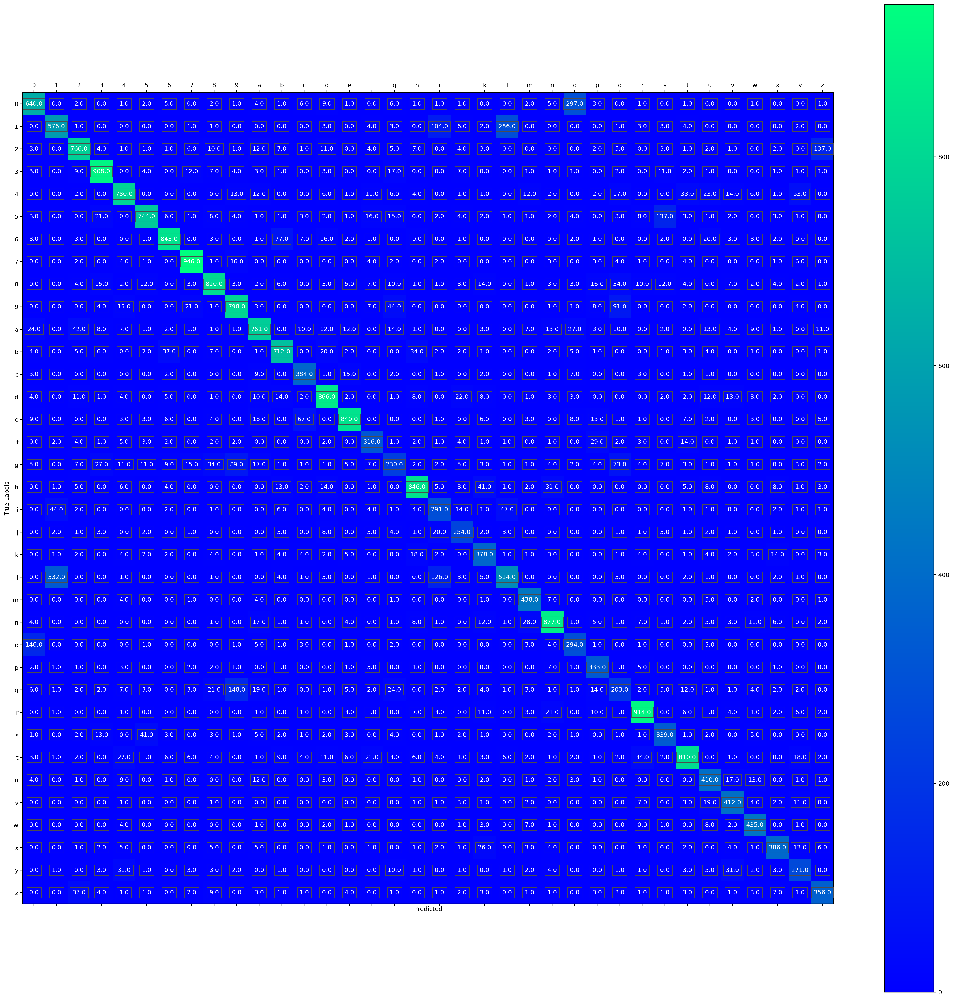

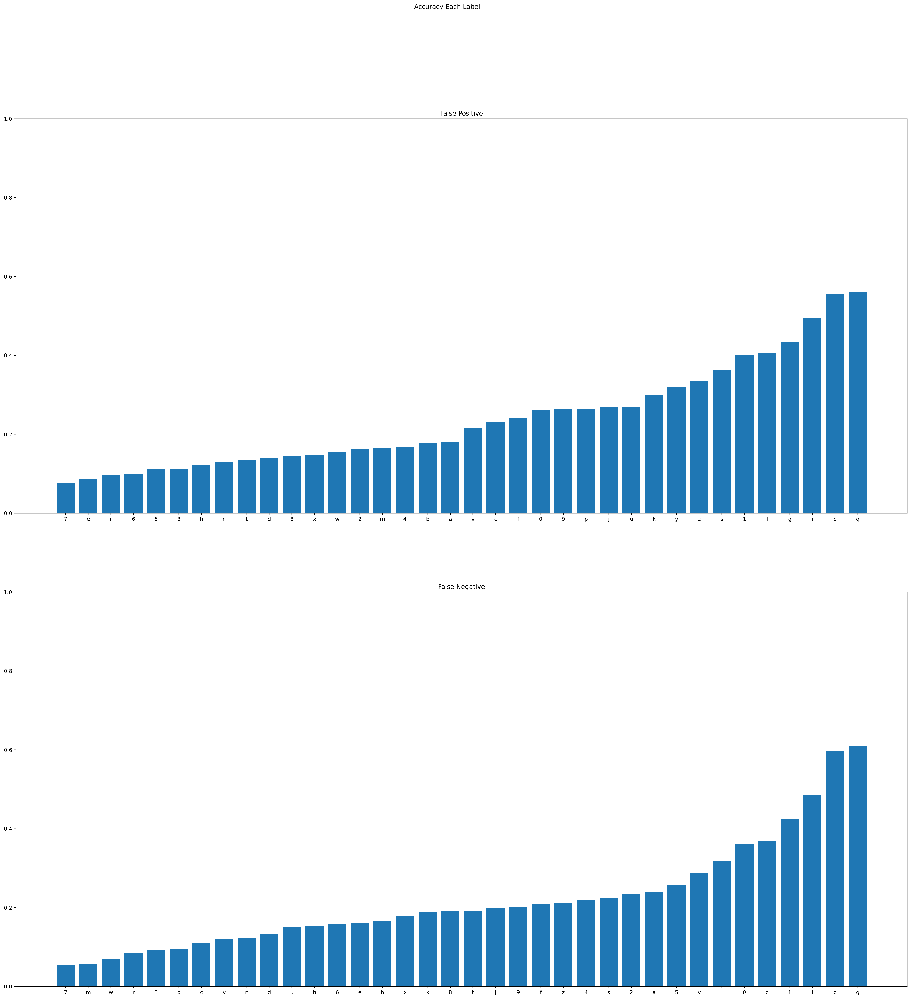

In [15]:
matplotlib.rcParams['figure.figsize'] = (30, 30)
PredictedTestLabels = Model.predict(TestEmbeddings)
Conmat = ConfusionMatrix(TestY, PredictedTestLabels)
Conmat.visualize()
Conmat.report()

### Separating by Large Sub classes With LDA + PCA using Rand Forest 

Over all separation is the worse among all, WITH WEAKED CLASS WEIGHT, We increase the probability of classifying as a digits, and it in deed, is a digit. 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 200 out of 200 | elapsed:    0.4s finished
[Parallel(n_jobs=16)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=16)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=16)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=16)]: Done 200 out of 200 | elapsed:    0.0s finished


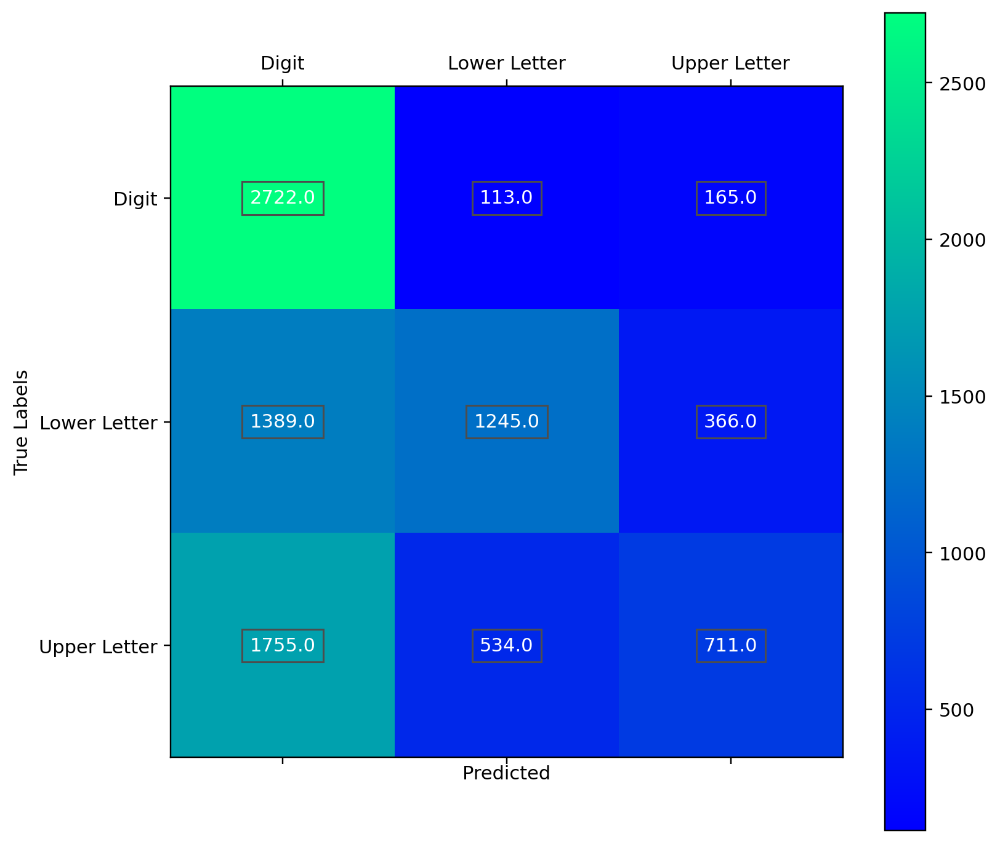

Over all accuracy is: 0.5197777777777778


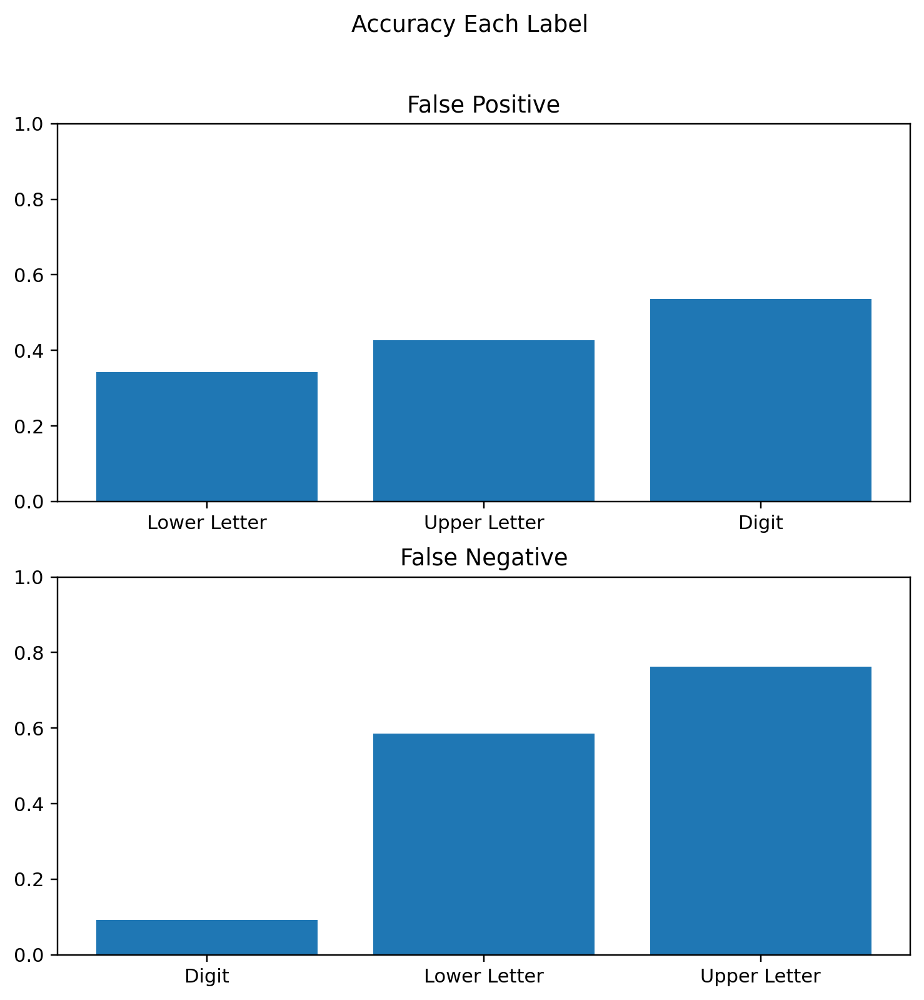

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 200 out of 200 | elapsed:    0.2s finished
[Parallel(n_jobs=16)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=16)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=16)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=16)]: Done 200 out of 200 | elapsed:    0.0s finished


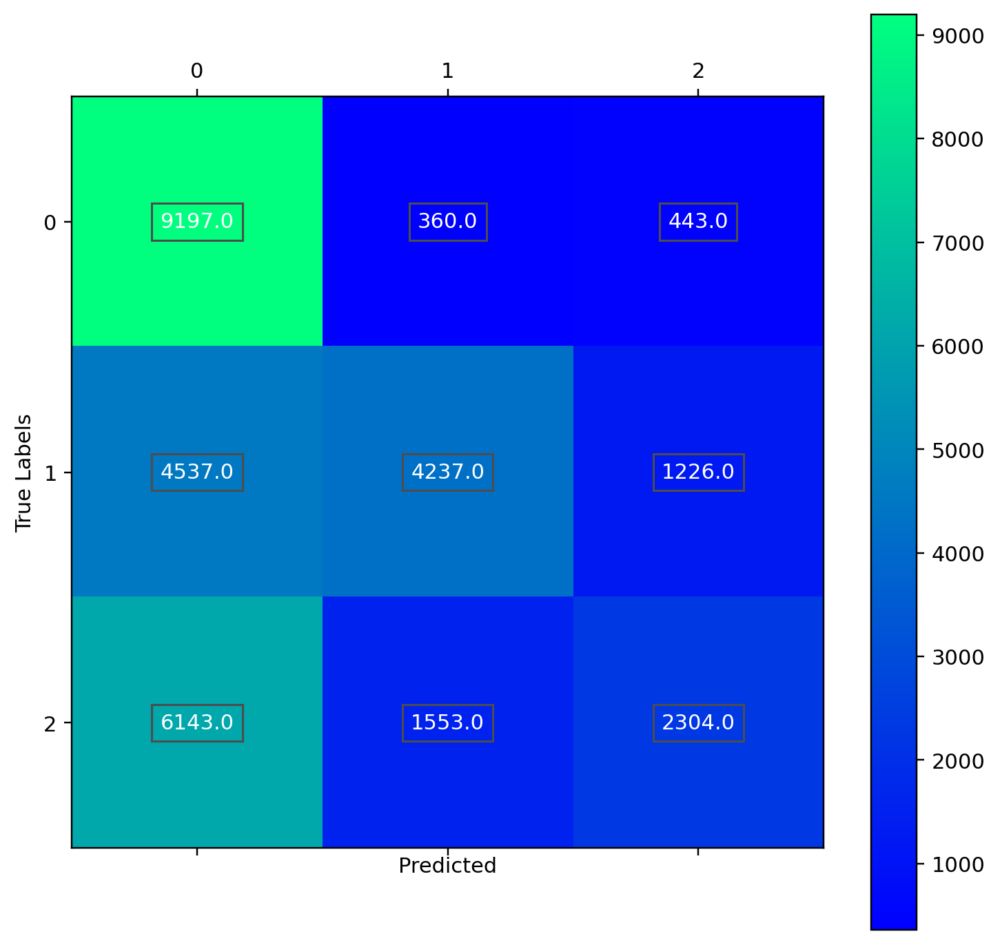

Over all accuracy is: 0.5246


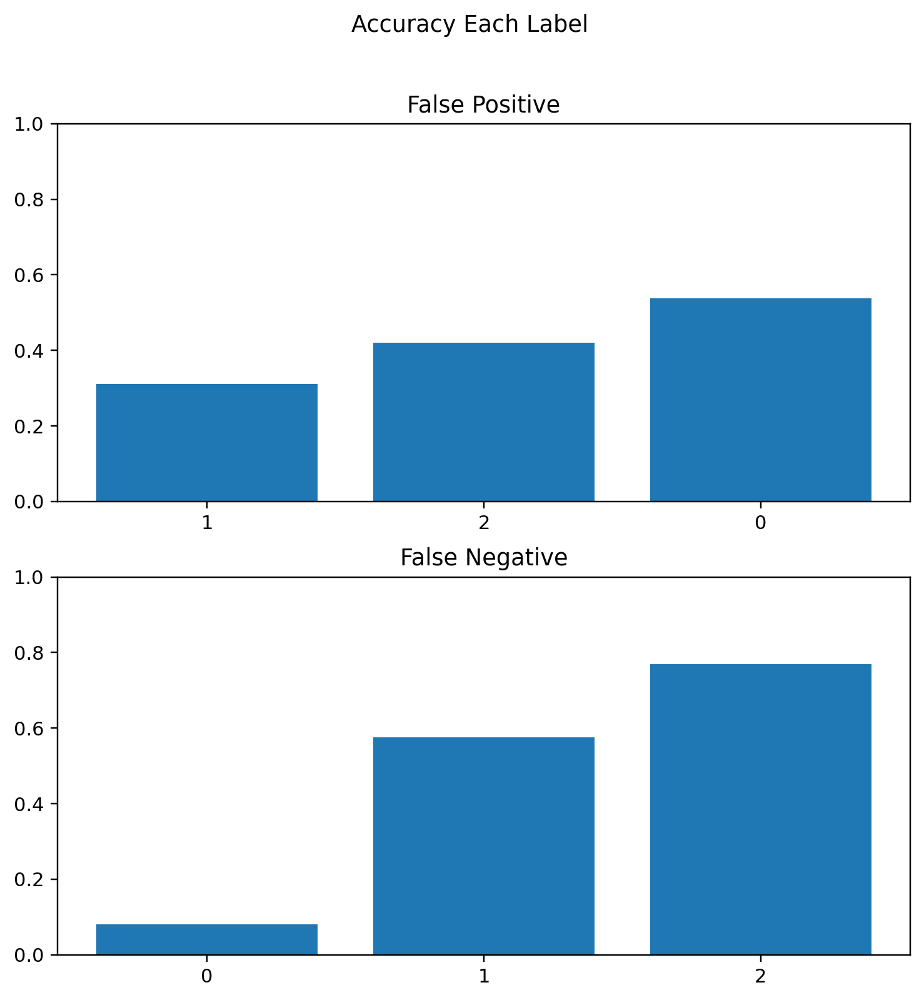

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 200 out of 200 | elapsed:    0.2s finished


RandomForestClassifier(class_weight={0: 3, 1: 1, 2: 1}, min_samples_leaf=0.01,
                       n_estimators=200, n_jobs=-1, verbose=1)

In [4]:
TrainX, TrainY, _, _, AxTicks = SplitByFunc(THREE_CLS_AUX_FUN, classSize=10000)
TestX, TestY, _, _, _ = SplitByFunc(THREE_CLS_AUX_FUN, classSize=3000,test_set=True)

DimRe = DimReduceHybrid(X=TrainX, y=TrainY)  # Use Train set to create LDA embeddings.
TrainEmbeddings = DimRe.getEmbeddings()  # Get Embeddings from the set trained LDA
TestEmbeddings = DimRe.getEmbeddings(TestX)  # Get the embeddings from the test set.

# Model = RandomForestClassifier(n_estimators=100, n_jobs=-1, max_leaf_nodes=)
Model = RandomForestClassifier(n_estimators=200,
                               n_jobs=-1,
                               verbose=1,
                               min_samples_leaf=0.01,
                               class_weight={0:3, 1: 1, 2: 1})
Model.fit(TrainEmbeddings, TrainY)
TestLabelsPredicted = Model.predict(TestEmbeddings)
Conmat = ConfusionMatrix(TestY, TestLabelsPredicted, axisTicks=AxTicks)
matplotlib.rcParams['figure.figsize'] = (8, 8)  # Graphics settings
Conmat.visualize()
show()
Conmat.report()
show()
Model.fit(TestEmbeddings, TestY)

TrainlabelsPredicted = Model.predict(TrainEmbeddings)
Conmat = ConfusionMatrix(TrainY, TrainlabelsPredicted)

Conmat.visualize()
show()
Conmat.report()
show()
Model.fit(TestEmbeddings, TestY)

### Binary Classification Between Digits and Data


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 200 out of 200 | elapsed:    0.4s finished
[Parallel(n_jobs=16)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=16)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=16)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=16)]: Done 200 out of 200 | elapsed:    0.0s finished


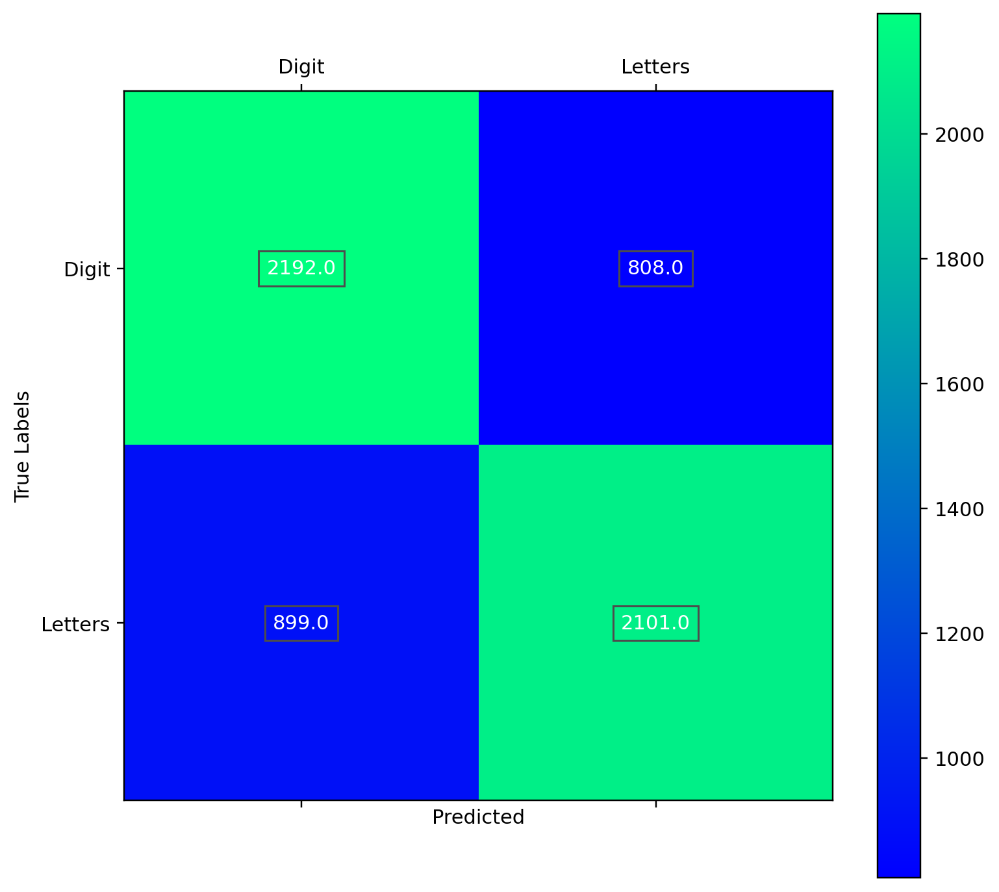

Over all accuracy is: 0.7155


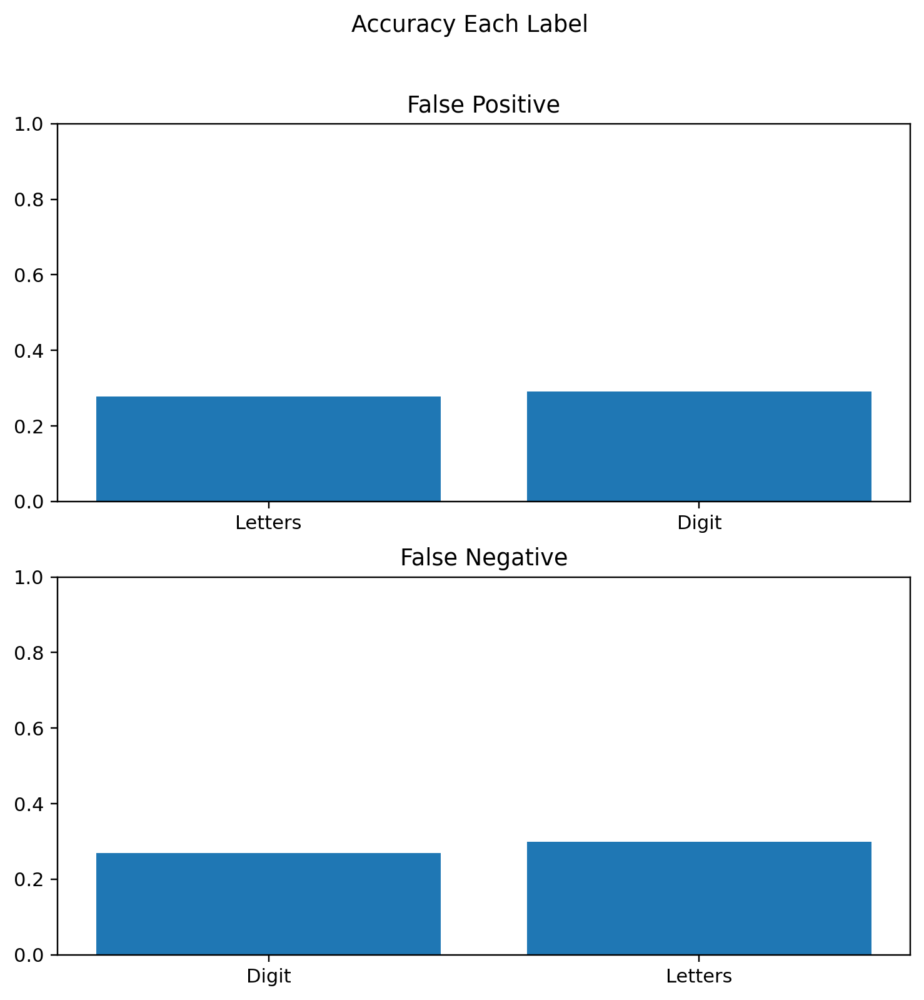

[Parallel(n_jobs=16)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=16)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=16)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=16)]: Done 200 out of 200 | elapsed:    0.0s finished


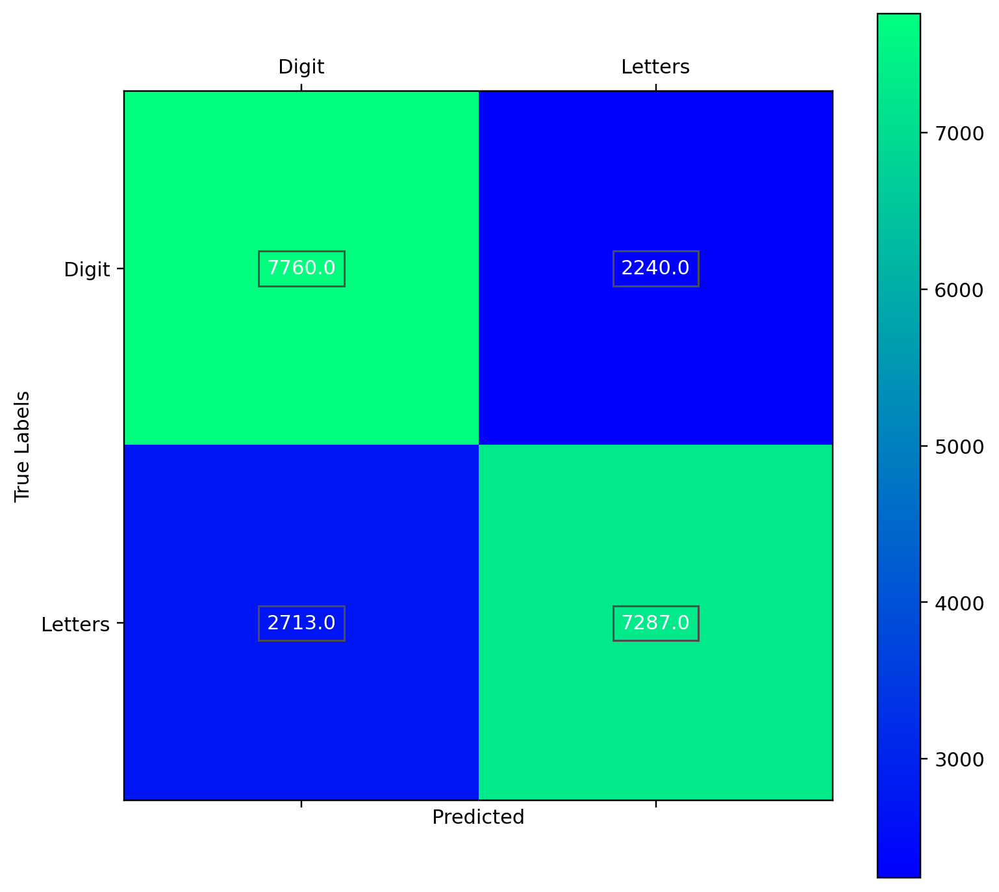

Over all accuracy is: 0.75235


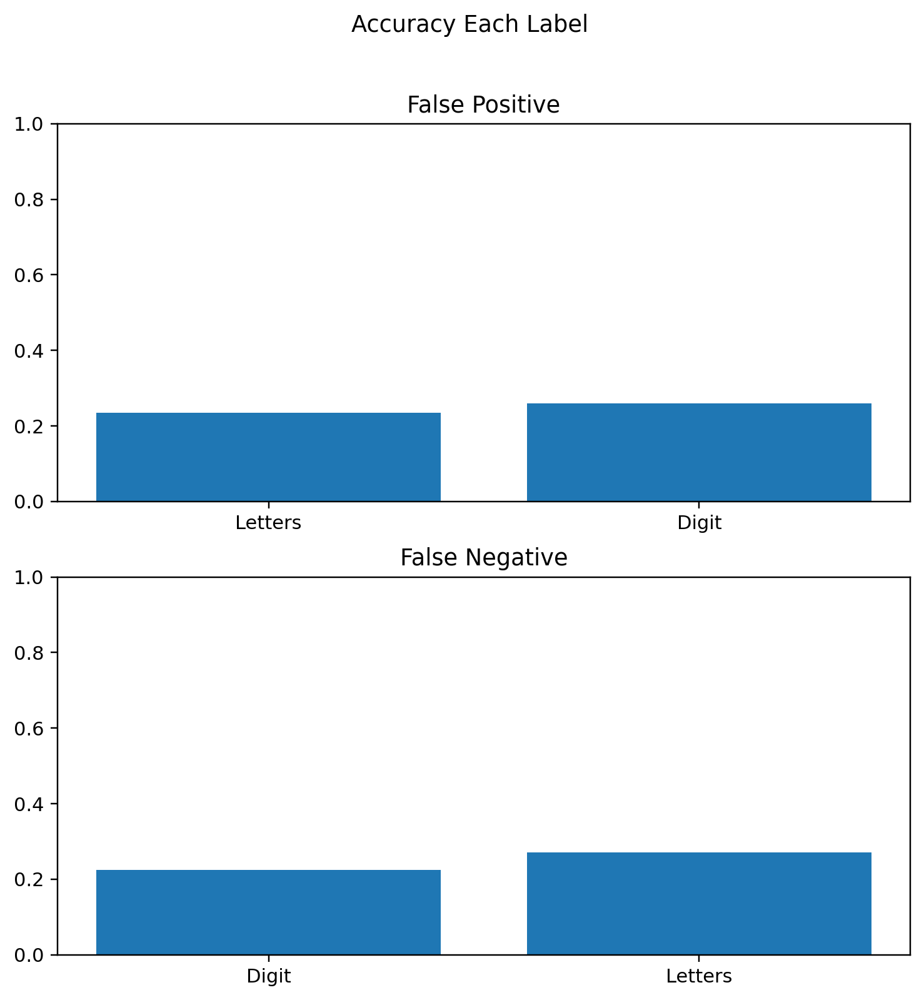

In [11]:
TrainX, TrainY, _, _, AxTicks = SplitByFunc(TWO_CLS_AUX_FUN, classSize=10000)
TestX, TestY, _, _, _ = SplitByFunc(TWO_CLS_AUX_FUN, classSize=3000,test_set=True)

DimRe = DimReduceHybrid(X=TrainX, y=TrainY)  # Use Train set to create LDA embeddings.
TrainEmbeddings = DimRe.getEmbeddings()  # Get Embeddings from the set trained LDA
TestEmbeddings = DimRe.getEmbeddings(TestX)  # Get the embeddings from the test set.

# Model = RandomForestClassifier(n_estimators=100, n_jobs=-1, max_leaf_nodes=)
Model = RandomForestClassifier(n_estimators=200,
                               n_jobs=-1,
                               verbose=1,
                               min_samples_leaf=0.001,
                               class_weight={0: 1, 1: 1})
Model.fit(TrainEmbeddings, TrainY)
TestLabelsPredicted = Model.predict(TestEmbeddings)
Conmat = ConfusionMatrix(TestY, TestLabelsPredicted, axisTicks=AxTicks)
matplotlib.rcParams['figure.figsize'] = (8, 8)  # Graphics settings
Conmat.visualize()
show()
Conmat.report()
show()

TrainlabelsPredicted = Model.predict(TrainEmbeddings)
Conmat = ConfusionMatrix(TrainY, TrainlabelsPredicted, axisTicks=AxTicks)

Conmat.visualize()
show()
Conmat.report()
show()

### Random Forest on the Digits


In [15]:
Symbols = "".join(map(str, range(10)))
classes = [SymbolsToLabels(II) for II in Symbols]
TrainX, TrainY = SplitbyClasses(classes=classes, classSize=float("inf"))
TestX, TestY = SplitbyClasses(classes=classes, classSize=1000, shuffle_data=True, test_set=True)

DimRe = DimReduceHybrid(X=TrainX, y=TrainY, pca_components=0.9)  # Use Train set to create LDA embeddings.
TrainEmbeddings = DimRe.getEmbeddings()  # Get Embeddings from the set trained LDA
TestEmbeddings = DimRe.getEmbeddings(TestX)  # Get the embeddings from the test set.

Model = RandomForestClassifier(n_estimators=200, n_jobs=-1)
Model.fit(TrainEmbeddings, TrainY)

RandomForestClassifier(n_estimators=200, n_jobs=-1)

Over all accuracy is: 0.9342


(<Figure size 6600x6600 with 2 Axes>,
 (<AxesSubplot:title={'center':'False Positive'}>,
  <AxesSubplot:title={'center':'False Negative'}>))

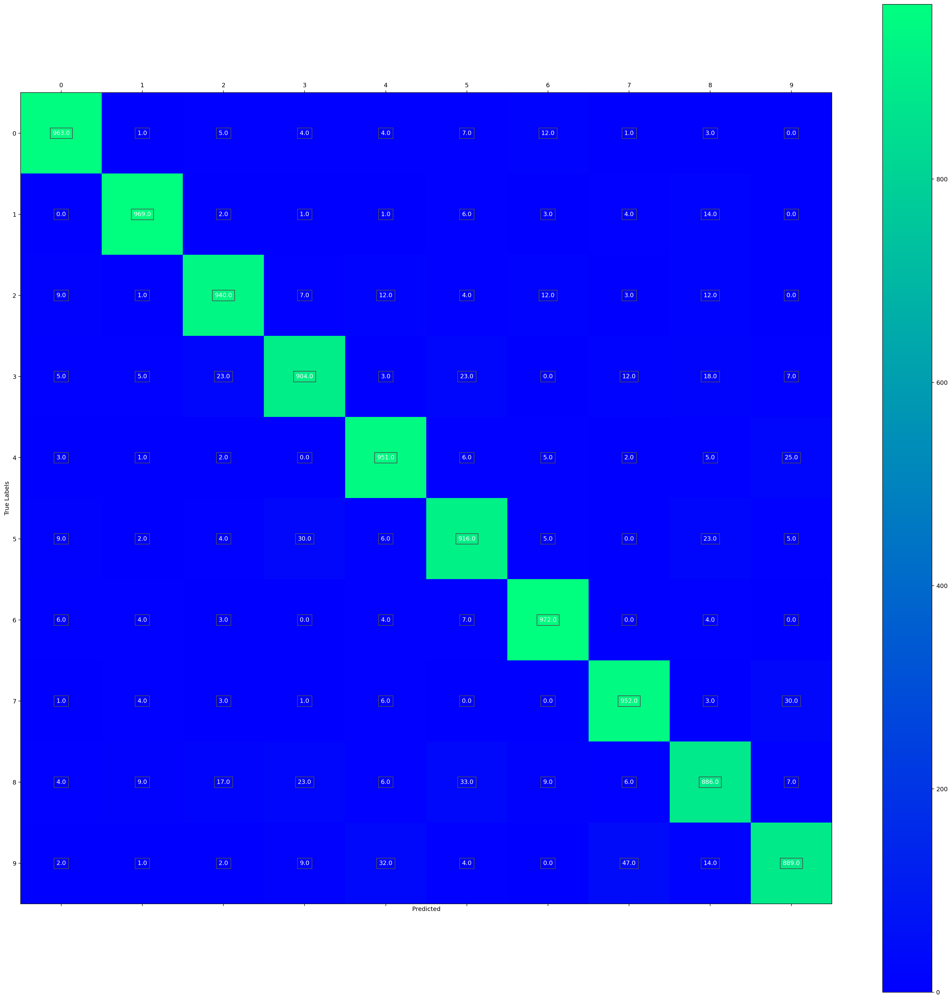

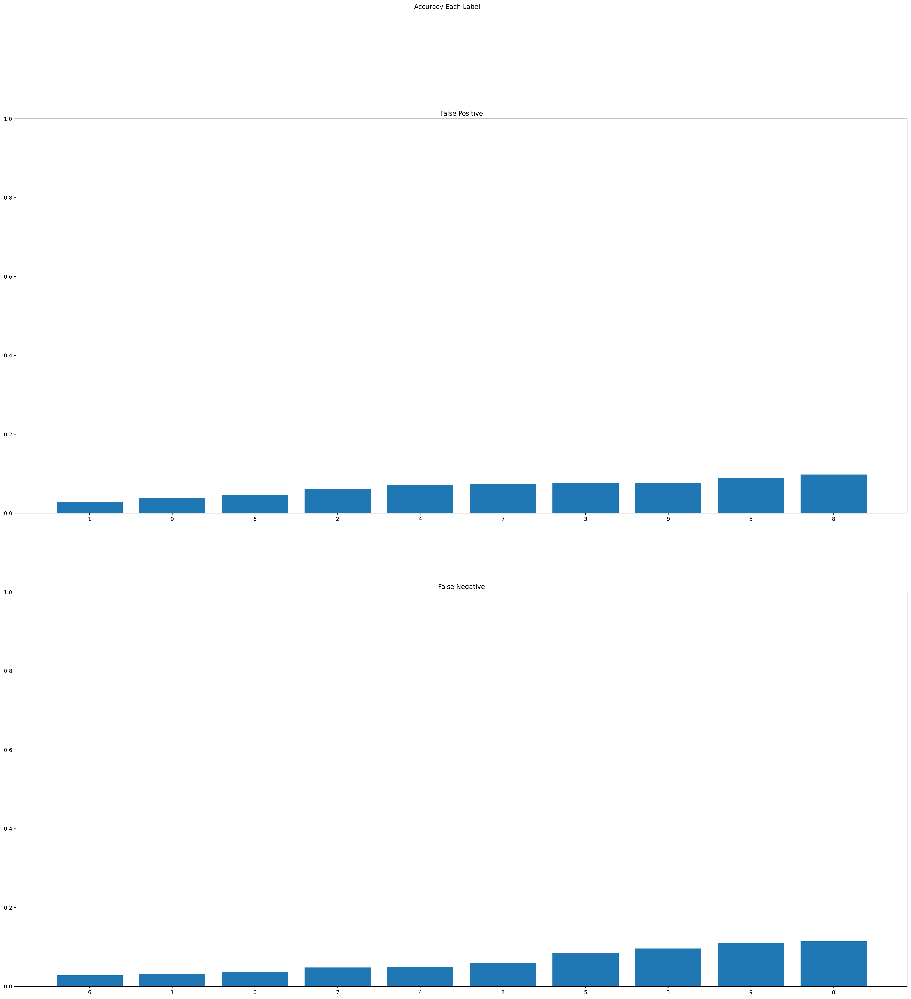

In [14]:
matplotlib.rcParams['figure.figsize'] = (30, 30)
PredictedTestLabels = Model.predict(TestEmbeddings)
Conmat = ConfusionMatrix(TestY, PredictedTestLabels)
Conmat.visualize()
Conmat.report()

### Reference Resources

---
#### Reference Materials Used:


SK: plotting the confusion chart
https://scikit-learn.org/stable/auto_examples/model_selection/plot_confusion_matrix.html


SK: LDA
https://scikit-learn.org/0.16/modules/generated/sklearn.lda.LDA.html#sklearn.lda.LDA.transform


SK: PCA
https://scikit-learn.org/stable/modules/generated/sklearn.decomposition.PCA.html


SK: Understanding the Decision Tree Structure:
https://scikit-learn.org/stable/auto_examples/tree/plot_unveil_tree_structure.html#sphx-glr-auto-examples-tree-plot-unveil-tree-structure-py


SK: Decision Tree
https://scikit-learn.org/stable/modules/tree.html#classification

Highlighting the pro and cons of using decision tree 


SK: RandomForestClassifier
https://scikit-learn.org/stable/modules/generated/sklearn.ensemble.RandomForestClassifier.html


A better version of decision tree. 


Research Paper: Solvers For SVM
https://leon.bottou.org/publications/pdf/lin-2006.pdf


Sk: SVM Complexity
https://scikit-learn.org/stable/modules/svm.html#complexity 
Hilighting the complexity for using the SVM classifier. 


Book: Elements of Statistical Learning:
Highlighting the reduction process of the SVM problem into a quadratic programming problem, and solver that focuses on KKT conditions and stuff like that. 


Medium Article:
https://towardsdatascience.com/entropy-how-decision-trees-make-decisions-2946b9c18c8
An introduction to decision tree, Information gain, entropy etc. 


Medium Article: 
https://towardsdatascience.com/an-illustrative-introduction-to-fishers-linear-discriminant-9484efee15ac
Putting Fisher's Discriminant Analysis into an optimization problem. 



#### Theoretical Part References 
